<a href="https://colab.research.google.com/github/FelixHAUD/ecommerce_eda/blob/main/ecommerce_eda_mgmt172.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Sourcing the data**

The data is being taken from [Harvard Dataverse](https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/YGLYDY).

# **The Imports**

First, the proper imports are needed and laid out. We'll be using pandas, numpy, matplotlib, datetime, and seaborn. These may not be installed, so use pip install to ensure that it is. If you do have it installed, it will note "Requirement already satistifed:".


In [5]:
!pip install pandas
!pip install numpy
!pip install matplotlib
!pip install seaborn

# Style
import typing as typ

# Plots & Dataframes
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Datatype
import datetime

pd.core.common.is_list_like = pd.api.types.is_list_like
%matplotlib inline


# **Reading the data**

Depending on how you do this, it may be different. If you are using a normal filesystem and not google colab, just use the file path. Note: you may have to add ./ even if its in the same folder.  

If you are using Google Colab, import the drive and mount the drive and follow and type the path manually. Note: you only have to mount the drive once, hence the separate code section.

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
amazon_purchases = pd.read_csv('/content/drive/MyDrive/MGMT 172 Team Folder/Final Project/dataverse_files/amazon-purchases.csv')
fields = pd.read_csv('/content/drive/MyDrive/MGMT 172 Team Folder/Final Project/dataverse_files/fields.csv')
survey = pd.read_csv('/content/drive/MyDrive/MGMT 172 Team Folder/Final Project/dataverse_files/survey.csv')
# amazon_purchases = pd.read_csv('/content/drive/MyDrive/data/amazon-purchases.csv')
# fields = pd.read_csv('/content/drive/MyDrive/data/fields.csv')
# survey = pd.read_csv('/content/drive/MyDrive/data/survey.csv')



In [8]:
# If you wish to view samples of the CSVs...

amazon_purchases.head(20)
fields.head()
# survey.head()

,Unnamed: 0,fields
0,Survey ResponseID,Response ID
1,Q-demos-age,What is your age group?
2,Q-demos-hispanic,"Are you of Spanish, Hispanic, or Latino origin?"
3,Q-demos-race,Choose one or more races that you consider you...
4,Q-demos-education,What is the highest level of education you hav...


# **Cleaning and combining data**

Now, depending on what the goal is, we have to combine and clean the CSV files.

In [9]:
df = amazon_purchases.merge(survey, on="Survey ResponseID", how='left')

# The CSV does not have dates converted to datetime format so we have to clean it here.
df['Order Date'] = pd.to_datetime(df['Order Date'], errors='coerce')

# This is just making it easier to sort the seasons
def sort_by_szn(m):
  if m in [12, 1, 2]:
    return 'Winter'
  elif m in [3, 4, 5]:
    return 'Spring'
  elif m in [6, 7, 8]:
    return 'Summer'
  else:
    return 'Fall'

# Map the season to which month it is
# Future note: Here you could also do this according to date, say like Christmas...
df['Season'] = df['Order Date'].dt.month.map(sort_by_szn)
df.head(20)

,Order Date,Purchase Price Per Unit,Quantity,Shipping Address State,Title,ASIN/ISBN (Product Code),Category,Survey ResponseID,Q-demos-age,Q-demos-hispanic,...,Q-substance-use-alcohol,Q-personal-diabetes,Q-personal-wheelchair,Q-life-changes,Q-sell-YOUR-data,Q-sell-consumer-data,Q-small-biz-use,Q-census-use,Q-research-society,Season
0,2018-12-04,7.98,1.0,NJ,SanDisk Ultra 16GB Class 10 SDHC UHS-I Memory ...,B0143RTB1E,FLASH_MEMORY,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Winter
1,2018-12-22,13.99,1.0,NJ,Betron BS10 Earphones Wired Headphones in Ear ...,B01MA1MJ6H,HEADPHONES,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Winter
2,2018-12-24,8.99,1.0,NJ,NaN,B078JZTFN3,NaN,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Winter
3,2018-12-25,10.45,1.0,NJ,Perfecto Stainless Steel Shaving Bowl. Durable...,B06XWF9HML,DISHWARE_BOWL,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Winter
4,2018-12-25,10.00,1.0,NJ,Proraso Shaving Cream for Men,B00837ZOI0,SHAVING_AGENT,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Winter
5,2019-02-18,10.99,1.0,NJ,Micro USB Cable Android Charger - Syncwire [2-...,B01GFB2E9M,COMPUTER_PROCESSOR,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Winter
6,2019-02-18,4.99,1.0,NJ,Amazon Basics USB 2.0 Charger Cable - A-Male t...,B00NH13S44,COMPUTER_ADD_ON,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Winter
7,2019-03-15,124.99,1.0,NJ,"Fire HD 8 Tablet (8"" HD Display, 32 GB, withou...",B077H6L7T9,AMAZON_TABLET,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Spring
8,2019-04-23,12.99,1.0,NJ,"Men's Leather Belt, Ratchet Dress Belt with Au...",B07L84ZZXC,APPAREL_BELT,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Spring
9,2019-04-23,24.69,1.0,NJ,NaN,B06XKNWJN2,NaN,R_01vNIayewjIIKMF,35 - 44 years,Yes,...,No,No,No,NaN,Yes if I get part of the profit,Yes if consumers get part of the profit,No,No,Yes,Spring


# **Overall Topic**

Our team chose to analyze the 2018-2022 seasonal product performance on Amazon by examining trends across their different product categories and consumer demographics. Seasonality plays a significant role in consumer behavior and market trends. Certain products and industries experience increased demand during specific seasons and holidays. Understanding these seasonal patterns can help businesses adjust their strategies.

# **Questions**

Which products exhibit seasonal purchasing patterns?

In [10]:
# df['Season'].value_counts()
season_cols = ['Fall','Spring','Summer','Winter']
# This is done considering quantity
pivot_quantity = df.pivot_table(
    index=['ASIN/ISBN (Product Code)'],
    columns='Season',
    values='Quantity',
    aggfunc='sum',
    fill_value=0
)

pivot_quantity['CV_SCORE'] = pivot_quantity.std(axis=1) / pivot_quantity.mean(axis=1)

# Filter out low value products (not enough sales or not sold through enough seasons to cross check)
min_total = 10
min_seasons = 2
mask_quantity = (
    (pivot_quantity.sum(axis=1)      >= min_total) &
    (pivot_quantity[season_cols].gt(0).sum(axis=1) >= min_seasons)
)
pivot_filtered_total = pivot_quantity[mask_quantity].copy()
# CV values of 2.0 indicate that there is a heavy lean towards certain seasons essentially
pivot_filtered_total = pivot_filtered_total.sort_values(by='CV_SCORE', ascending=False)

# Merged the title in as well just so it is easier to know what the product is
# also gets rid of duplicates
pivot_filtered_total = pivot_filtered_total.merge(df[['ASIN/ISBN (Product Code)', 'Title']].drop_duplicates(subset=['ASIN/ISBN (Product Code)']), on='ASIN/ISBN (Product Code)', how='left')
pivot_filtered_total.head(20)

,ASIN/ISBN (Product Code),Fall,Spring,Summer,Winter,CV_SCORE,Title
0,B093RV4X4Z,0.0,102.0,0.0,1.0,1.974195,Growing Up in a Pandemic
1,B08CYVLD85,1.0,0.0,0.0,66.0,1.960401,Amazon eGift Card - Decorated Tree
2,B09F1XPPHH,1.0,0.0,0.0,49.0,1.947032,Amazon.com eGift Card
3,B07BHKP8C9,0.0,34.0,1.0,0.0,1.924564,Amazon.com eGift Card
4,B00GHNJ1HC,0.0,1.0,0.0,31.0,1.917572,"EO Products Hand Sanitizer Spray for Everyone,..."
5,B01KIG1O8W,0.0,2.0,1.0,91.0,1.915209,Baby Proofing Cabinet Locks for Babies [12 Pac...
6,B071R3H9WB,1.0,0.0,0.0,30.0,1.914945,"Casio FX 260 Solar II Scientific Calculator 5""..."
7,B01N5DIRSF,24.0,0.0,0.0,1.0,1.894835,La Colombe Vanilla Draft Latte - 9 Fluid Ounce...
8,B08YP5MKY4,24.0,0.0,0.0,1.0,1.894835,"Kasa Smart Bulb, Dimmable Color Changing Light..."
9,B07YJFWNBR,0.0,0.0,1.0,24.0,1.894835,Amazon.com eGift Card


In [11]:
df = df.assign(
    _revenue = df['Quantity'] * df['Purchase Price Per Unit']
)

# This is done considering revenue
pivot_revenue = pd.pivot_table(
    df,
    index='ASIN/ISBN (Product Code)',
    columns='Season',
    values='_revenue',
    aggfunc='sum',
    fill_value=0
)

pivot_revenue['CV_SCORE'] = pivot_revenue.std(axis=1) / pivot_revenue.mean(axis=1)

# Filter out low value products (not enough sales or not sold through enough seasons to cross check)
min_revenue = 100
min_seasons = 2
mask_revenue = (
    (pivot_revenue.sum(axis=1)      >= min_revenue) &
    (pivot_revenue[season_cols].gt(0).sum(axis=1) >= min_seasons)
)
pivot_revenue_filtered_total = pivot_revenue[mask_revenue].copy()
# CV values of 2.0 indicate that there is a heavy lean towards certain seasons essentially
pivot_revenue_filtered_total = pivot_revenue_filtered_total.sort_values(by='CV_SCORE', ascending=False)

# Merged the title in as well just so it is easier to know what the product is
# also gets rid of duplicates
pivot_revenue_filtered_total = pivot_revenue_filtered_total.merge(df[['ASIN/ISBN (Product Code)', 'Title']].drop_duplicates(subset=['ASIN/ISBN (Product Code)']), on='ASIN/ISBN (Product Code)', how='left')


pivot_revenue_filtered_total.head(20)

,ASIN/ISBN (Product Code),Fall,Spring,Summer,Winter,CV_SCORE,Title
0,B0871WS93H,231.99,0.00,0.00,0.13,1.998507,"WestForce Electric Pressure Washer, 3000 PSI 1..."
1,B07YJFWNBR,0.00,0.00,1.00,1346.96,1.998022,Amazon.com eGift Card
2,B07HHVR8RR,0.00,1.00,0.00,685.00,1.996115,Amazon.com eGift Card
3,B094Q7RNLV,0.00,1.00,355.00,0.00,1.992516,Amazon.com eGift Card
4,B09F1S3QVS,138.02,1.00,0.00,0.00,1.980865,Amazon.com eGift Card
5,B09DCN7KLZ,0.00,1.00,0.00,100.00,1.973686,Amazon.com eGift Card
6,B0001TJ0WE,0.00,0.00,11.19,962.90,1.969485,"Herbal Conditioner for Normal Hair, with botan..."
7,B09BQRTGV6,2.00,0.00,120.00,0.00,1.956528,Amazon.com eGift Card
8,B08CZ2SGBF,10.00,0.00,0.00,585.00,1.955439,Amazon.com eGift Card
9,B09F1SDFQ3,3.00,0.00,0.00,156.18,1.950066,Amazon.com eGift Card


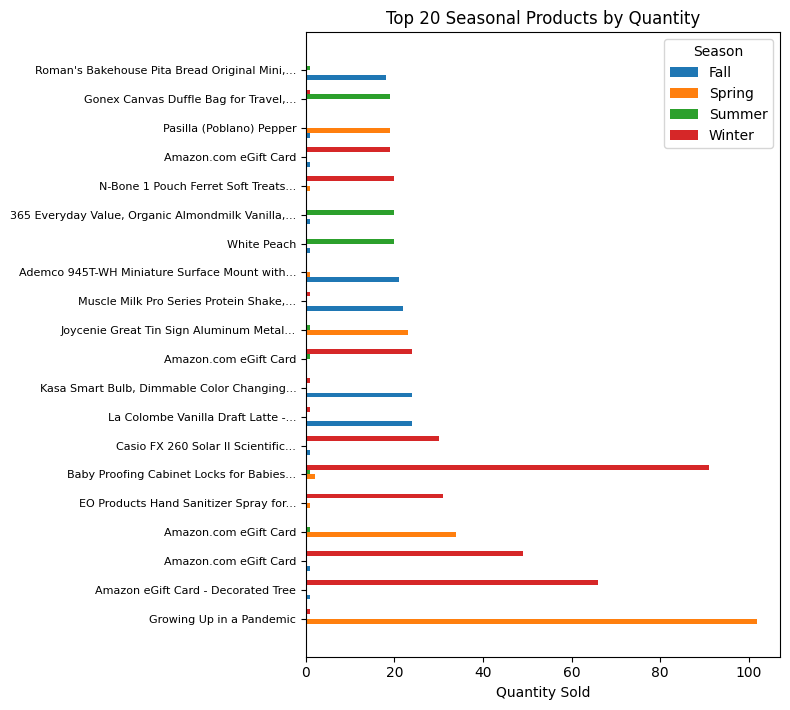

In [12]:
top_n = 20 # Change this to see as many products as you want

qty_pivot = pivot_filtered_total.copy().head(20)
rev_pivot = pivot_revenue_filtered_total.copy().head(20)

# Shortens the title so that on the charts everything fits nicely
def truncate_title(title, n_words=6):
    words = title.split()
    if len(words) <= n_words:
        return title
    return ' '.join(words[:n_words]) + '...'

titles = qty_pivot['Title'].tolist()
titles = [truncate_title(title) for title in titles] # Calls the function in a list comprehension

n_products = len(qty_pivot)
# Array of evenly spaced values
x = np.arange(n_products) # makes it so that there will be certain amount of columns
height = 0.2

cluster_height = height * 4 # 4 Seasons
gap = 0.4
cluster_pos = np.arange(n_products) * (cluster_height + gap)

# Initialized the actual chart
fig, ax = plt.subplots(figsize=(8, n_products * (cluster_height + gap) * 0.3))
for i, szn in enumerate(season_cols):
    ax.barh(cluster_pos + i * height, qty_pivot[szn], height, label=szn)

tick_positions = cluster_pos + (cluster_height / 2) - (height / 2)
ax.set_yticks(tick_positions)
ax.set_yticklabels(titles, fontsize=8)

ax.set_xlabel('Quantity Sold')
ax.set_title(f'Top {n_products} Seasonal Products by Quantity')
ax.legend(title='Season', bbox_to_anchor=(1.0, 1.0))
plt.tight_layout()
plt.show()


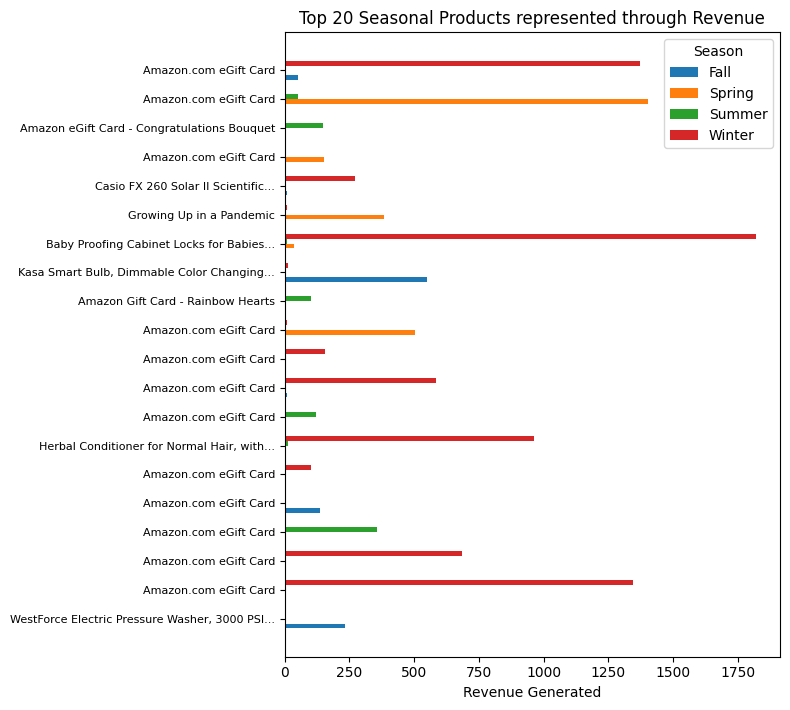

In [13]:
# Repeating the same activity but by revenue

rev_titles = rev_pivot['Title'].tolist()
rev_titles = [truncate_title(title) for title in rev_titles]

fig, bx = plt.subplots(figsize=(8, n_products * (cluster_height + gap) * 0.3))

# draw bars for each season
for i, szn in enumerate(season_cols):
    bx.barh(cluster_pos + i * height, rev_pivot[szn], height, label=szn)
tick_positions = cluster_pos + (cluster_height / 2) - (height / 2)
bx.set_yticks(tick_positions)
bx.set_yticklabels(rev_titles, fontsize=8)

# Legend, y tick locations, and centered titles
bx.set_xlabel('Revenue Generated')
bx.set_title(f'Top {n_products} Seasonal Products represented through Revenue')
bx.legend(title='Season', bbox_to_anchor=(1.0, 1.0))

# Adjust layout and plot
plt.tight_layout()
plt.show()

# Next on the list:

Now that we've found the products that perform seasonally, let's look at which products are in the:

**Fall
Spring
Summer
Winter**

In [14]:
# Find the top 5 products doing the best in each season

qty_long = pivot_filtered_total.copy()[['ASIN/ISBN (Product Code)', 'Title'] + season_cols]
qty_long = qty_long.melt(id_vars=['ASIN/ISBN (Product Code)', 'Title'],
              value_vars=season_cols,
              var_name = 'Season',
              value_name='Quantity',
              )
top5_qty = (
    qty_long
      .groupby('Season', group_keys=False)
      .apply(lambda x: x.nlargest(5, 'Quantity'))
      .reset_index(drop=True)
)
top5_qty

<ipython-input-14-93a4026f8d57>:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(5, 'Quantity'))


,ASIN/ISBN (Product Code),Title,Season,Quantity
0,B086KKT3RX,Amazon Reload,Fall,2287.0
1,B00IX1I3G6,Amazon.com Gift Card Balance Reload,Fall,2094.0
2,B079NF2NFW,Photo Prints – Glossy – Standard Size (4x5.3),Fall,457.0
3,B07PCMWTSG,Amazon.com eGift Card,Fall,371.0
4,B0711H8L7V,Photo Prints – Glossy – Standard Size (4x6),Fall,330.0
5,B00IX1I3G6,Amazon.com Gift Card Balance Reload,Spring,3062.0
6,B086KKT3RX,Amazon Reload,Spring,975.0
7,B0711H8L7V,Photo Prints – Glossy – Standard Size (4x6),Spring,525.0
8,B07PCMWTSG,Amazon.com eGift Card,Spring,416.0
9,B004LLIKVU,Amazon.com eGift Card,Spring,378.0


In [15]:
# Same as above, but using revenue as a measurement.

rev_long = pivot_revenue_filtered_total.copy()[['ASIN/ISBN (Product Code)', 'Title'] + season_cols]
rev_long = rev_long.melt(id_vars=['ASIN/ISBN (Product Code)', 'Title'],
              value_vars=season_cols,
              var_name = 'Season',
              value_name='Revenue',
              )
top5_rev = (
    rev_long
      .groupby('Season', group_keys=False)
      .apply(lambda x: x.nlargest(5, 'Revenue'))
      .reset_index(drop=True)
)
top5_rev

<ipython-input-15-1aadef4b31c3>:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(5, 'Revenue'))


,ASIN/ISBN (Product Code),Title,Season,Revenue
0,B00IX1I3G6,Amazon.com Gift Card Balance Reload,Fall,50031.46
1,B086KKT3RX,Amazon Reload,Fall,42639.82
2,B09BZ4VF5R,Amazon.com eGift Card,Fall,17335.00
3,B07PXGQC1Q,Apple AirPods (2nd Generation) Wireless Earbud...,Fall,15734.28
4,B07PCMWTSG,Amazon.com eGift Card,Fall,15524.37
5,B00IX1I3G6,Amazon.com Gift Card Balance Reload,Spring,64481.06
6,B086KKT3RX,Amazon Reload,Spring,20481.48
7,B07PCMWTSG,Amazon.com eGift Card,Spring,10568.45
8,B004LLIKVU,Amazon.com eGift Card,Spring,10447.26
9,B074T91QTZ,Google Play gift code - give the gift of games...,Spring,7824.54


Create a loop to create all the tables in one ago considering that they are all similar formats!

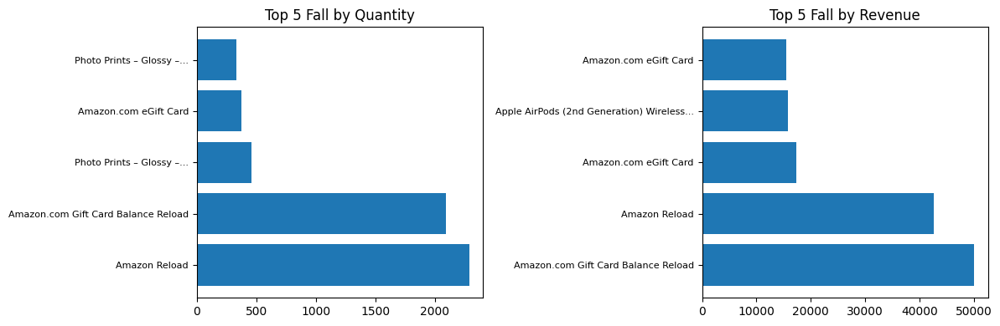

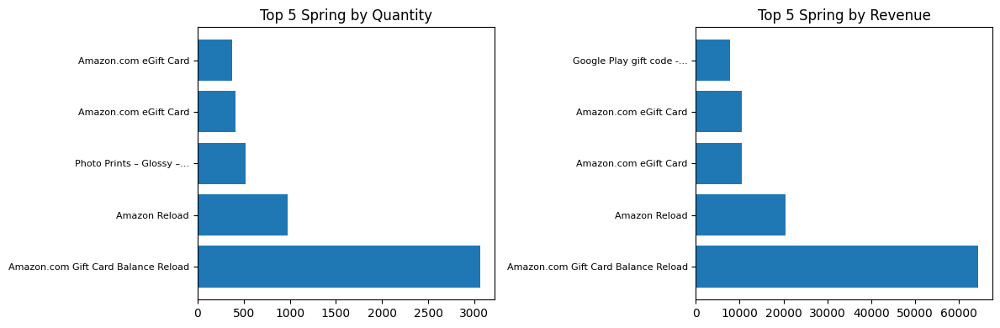

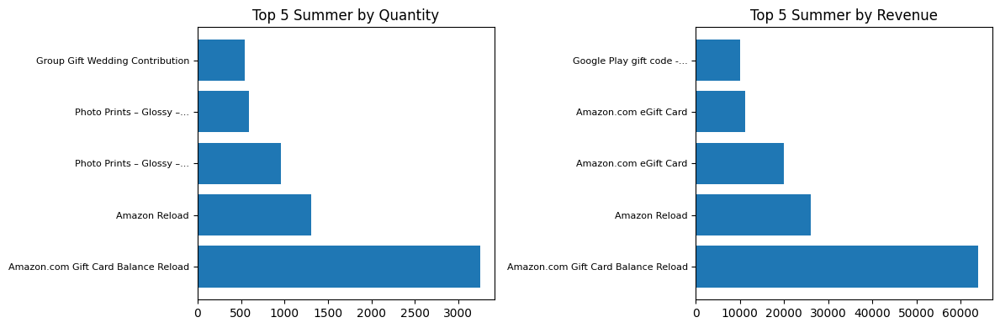

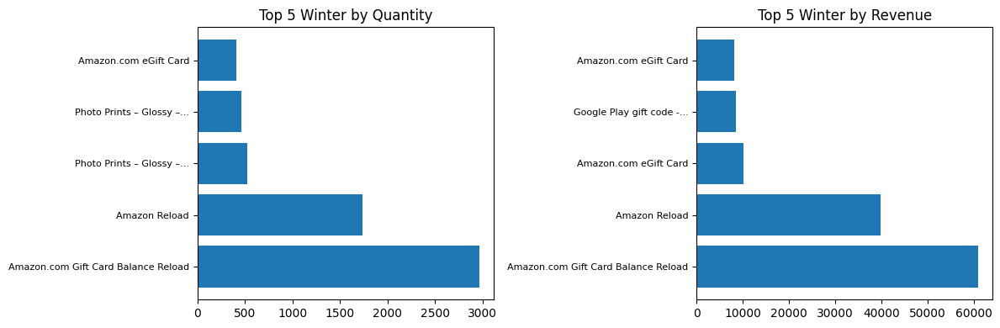

In [16]:
set_bars = 5 # If you happen to take more products above and they have the same name, you need to adjust this as well
for season in season_cols:
  y = np.arange(set_bars)

  df_qty = top5_qty[top5_qty['Season'] == season].copy()
  df_rev = top5_rev[top5_rev['Season'] == season].copy()

  df_qty['ShortTitle'] = df_qty['Title'].apply(lambda t: truncate_title(t, n_words=5))
  df_rev['ShortTitle'] = df_rev['Title'].apply(lambda t: truncate_title(t, n_words=5))

  fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,4))
  ax1.barh(y, df_qty['Quantity'], height=0.8)
  ax1.set_yticks(y)
  ax1.set_yticklabels(df_qty['ShortTitle'], fontsize=8)
  ax1.set_title(f"Top 5 {season} by Quantity")

  ax2.barh(y, df_rev['Revenue'], height=0.8)
  ax2.set_yticks(y)
  ax2.set_yticklabels(df_rev['ShortTitle'], fontsize=8)
  ax2.set_title(f"Top 5 {season} by Revenue")

  fig.tight_layout()
  plt.show()



# Why are these products specifically trending?


---



---


Now we're going to check if across the demographic data that was provided by the harvard dataset. This could provide some insights on why certain products are being pushed so hard.

# First we'll take a look based on age demographics.


In [17]:
def get_column_label_for_demographic(demographic):
  '''
  Lookup table so that the text can match up with the column title and its easier to create the charts
  '''
  lookup = {
      "Age Group": "Q-demos-age",
      "Income Bracket": "Q-demos-income",
      "Gender": "Q-demos-gender",
      "Sexual Orientation": "Q-sexual-orientation",
      "Education Level": "Q-demos-education",
      "State": "Q-demos-state"
  }
  try:
    return lookup[demographic]
  except KeyError:
    raise ValueError(f"Unknown demographic “{demographic}”")

In [18]:
df = df.assign(_revenue = df['Quantity'] * df['Purchase Price Per Unit'])
# So that there is a title in the table for readability
title_map = (
    df[['ASIN/ISBN (Product Code)', 'Title']]
      .drop_duplicates(subset='ASIN/ISBN (Product Code)')
      .set_index('ASIN/ISBN (Product Code)')['Title']
)
# season_cols defined as [summer, fall...]
def demographic_breakdown_df(df, title_map, top5_qty, top5_rev, demographic=None) -> typ.Tuple[pd.DataFrame, pd.DataFrame]:
  demographic_column_label = get_column_label_for_demographic(demographic)
  qty_by_season = {}
  rev_by_season = {}
  for season in season_cols:
    print(f"\n---- {season} Demographic Breakdown ----\n")

    top_asins_qty = top5_qty[top5_qty['Season']==season]['ASIN/ISBN (Product Code)']
    top_asins_rev = top5_rev[top5_rev['Season']==season]['ASIN/ISBN (Product Code)']

    df_season_qty = df[(df['Season']==season) & df['ASIN/ISBN (Product Code)'].isin(top_asins_qty)]

    df_season_rev = df[(df['Season']==season) & df['ASIN/ISBN (Product Code)'].isin(top_asins_rev)]
    d_qty = (
          df_season_qty
          .groupby(['ASIN/ISBN (Product Code)', demographic_column_label])['Quantity']
          .sum()
          .unstack(fill_value=0)
      )
    d_qty['Title'] = d_qty.index.map(title_map)
    d_rev = (
          df_season_rev
          .groupby(['ASIN/ISBN (Product Code)', demographic_column_label])['_revenue']
          .sum()
          .unstack(fill_value=0)
      )
    d_rev['Title'] = d_rev.index.map(title_map)

    print(f"Quantity by {demographic}:")
    display(d_qty)
    print(f"Revenue by {demographic}:")
    display(d_rev)
    qty_by_season[season] = d_qty
    rev_by_season[season] = d_rev

  return qty_by_season, rev_by_season

age_qty, age_rev = demographic_breakdown_df(df, title_map, top5_qty, top5_rev, demographic="Age Group")




---- Fall Demographic Breakdown ----

Quantity by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B00IX1I3G6,108.0,912.0,670.0,234.0,111.0,59.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,0.0,106.0,219.0,5.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,0.0,100.0,353.0,0.0,4.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B07PCMWTSG,18.0,117.0,163.0,38.0,19.0,16.0,Amazon.com eGift Card
B086KKT3RX,145.0,914.0,716.0,305.0,165.0,42.0,Amazon Reload


Revenue by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B00IX1I3G6,2949.20,15061.28,16982.58,7860.44,5006.99,2170.97,Amazon.com Gift Card Balance Reload
B07PCMWTSG,488.34,3141.81,8453.11,1608.80,1041.82,790.49,Amazon.com eGift Card
B07PXGQC1Q,2640.85,5337.78,4166.83,2539.89,939.93,109.00,Apple AirPods (2nd Generation) Wireless Earbud...
B086KKT3RX,2506.45,13900.26,15661.99,5249.59,3485.77,1835.76,Amazon Reload
B09BZ4VF5R,28.00,155.00,16907.00,245.00,0.00,0.00,Amazon.com eGift Card



---- Spring Demographic Breakdown ----

Quantity by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B004LLIKVU,9.0,74.0,167.0,45.0,73.0,10.0,Amazon.com eGift Card
B00IX1I3G6,149.0,1251.0,1020.0,414.0,163.0,65.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,37.0,383.0,13.0,92.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B07PCMWTSG,39.0,123.0,108.0,111.0,23.0,12.0,Amazon.com eGift Card
B086KKT3RX,34.0,358.0,333.0,147.0,71.0,32.0,Amazon Reload


Revenue by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B004LLIKVU,499.73,2135.13,3371.94,2396.02,1743.59,300.85,Amazon.com eGift Card
B00IX1I3G6,4426.84,17660.70,21970.83,11035.24,7552.94,1834.51,Amazon.com Gift Card Balance Reload
B074T91QTZ,307.00,2488.66,4818.88,30.00,155.00,25.00,Google Play gift code - give the gift of games...
B07PCMWTSG,973.51,3707.83,2566.54,2158.28,874.29,288.00,Amazon.com eGift Card
B086KKT3RX,1116.57,6931.78,6272.51,3483.23,1291.36,1386.03,Amazon Reload



---- Summer Demographic Breakdown ----

Quantity by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B00IX1I3G6,187.0,1624.0,854.0,350.0,166.0,69.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,9.0,360.0,486.0,102.0,4.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B071DPM9RD,11.0,476.0,50.0,3.0,0.0,0.0,Group Gift Wedding Contribution
B079NF2NFW,1.0,305.0,102.0,188.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,85.0,532.0,431.0,153.0,83.0,23.0,Amazon Reload


Revenue by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B004LLIKVU,709.98,3619.84,4385.75,1161.79,1045.55,217.43,Amazon.com eGift Card
B00IX1I3G6,3685.43,21376.53,19923.52,10056.84,6701.64,2239.01,Amazon.com Gift Card Balance Reload
B074T91QTZ,458.21,2609.54,6700.00,107.00,75.00,25.00,Google Play gift code - give the gift of games...
B07PCMWTSG,1328.57,7721.28,6242.44,1669.89,2574.61,315.00,Amazon.com eGift Card
B086KKT3RX,1907.98,8248.38,8609.58,3548.19,2338.19,1444.35,Amazon Reload



---- Winter Demographic Breakdown ----

Quantity by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B004LLIKVU,19.0,97.0,166.0,49.0,72.0,4.0,Amazon.com eGift Card
B00IX1I3G6,139.0,1312.0,957.0,339.0,134.0,86.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,0.0,151.0,198.0,171.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,0.0,88.0,168.0,204.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,112.0,676.0,546.0,275.0,76.0,52.0,Amazon Reload


Revenue by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,45 - 54 years,55 - 64 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,,,
B004LLIKVU,330.94,3380.78,3309.52,1214.16,1782.63,159.90,Amazon.com eGift Card
B00IX1I3G6,3181.88,20535.51,19626.33,9109.16,5609.03,2954.40,Amazon.com Gift Card Balance Reload
B074T91QTZ,581.42,2804.18,4635.00,265.00,150.00,25.00,Google Play gift code - give the gift of games...
B07PCMWTSG,533.51,2614.02,2766.34,1324.07,626.33,216.62,Amazon.com eGift Card
B086KKT3RX,2566.10,12939.41,14272.61,5529.45,2371.05,2239.09,Amazon Reload


In [19]:
def plot_by_group(age_rev_df, figsize=(10, None), bar_width=0.8, value_type=None, demographic=None) -> typ.Tuple[plt.figure, plt.axes]:
  '''
  Creates a plot by group
  '''
  age_rev_reset = age_rev_df.reset_index()
  age_rev_reset['ShortTitle'] = age_rev_reset['Title'].apply(lambda t: truncate_title(t, n_words=5))
  plot_df = age_rev_reset.set_index('ShortTitle')

  age_groups = [col for col in plot_df.columns if col not in ['ASIN/ISBN (Product Code)']]
  plot_df = plot_df[age_groups]

  fig, ax = plt.subplots(figsize=(10, len(plot_df)*0.4 + 1))
  plot_df.plot(kind='barh', ax=ax, width=0.8)

  xlabel = f"{value_type}" + (" ($)" if value_type == 'Revenue' else "")
  ax.set_xlabel(xlabel)
  ax.set_ylabel('Product Title')
  ax.set_title(f'{value_type} by {demographic} for Top Season Products')
  ax.legend(
    title=demographic,
    bbox_to_anchor=(1.0, 1.0, 0.2, 0.3),
    loc='upper left',
    bbox_transform=ax.transAxes,
    borderaxespad=0.5,
    frameon=True
  )
  return fig, ax


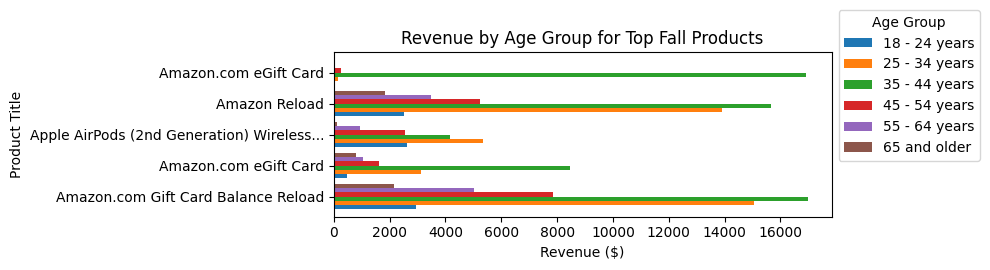

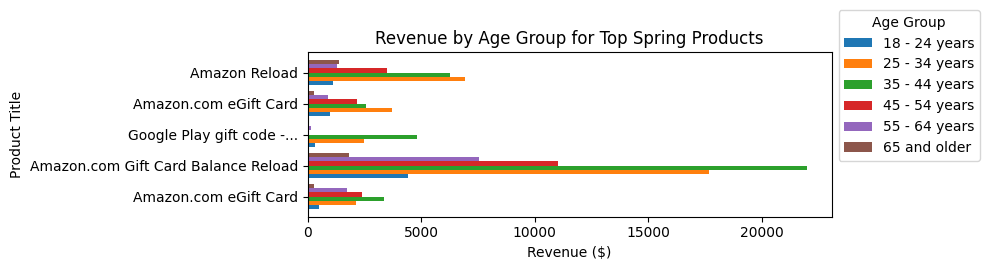

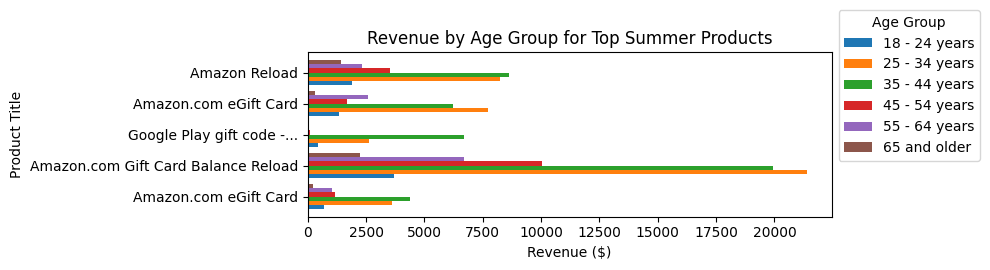

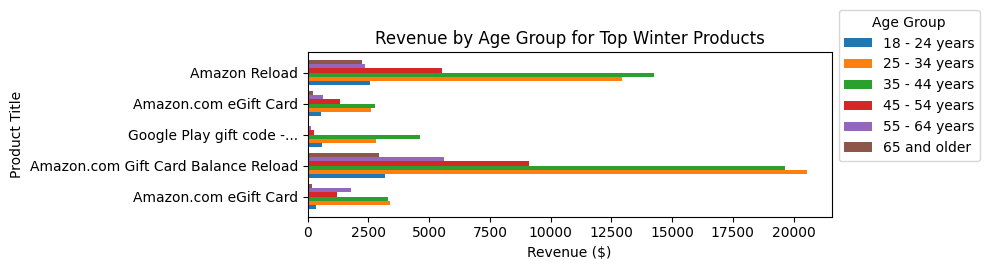

In [20]:
# Age | Revenue | Chart

for season, age_rev_df in age_rev.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        age_rev_df,
        value_type="Revenue",
        demographic="Age Group"
    )
    # override the title to include the season
    ax.set_title(f"Revenue by Age Group for Top {season} Products")
    plt.tight_layout()
    plt.show()

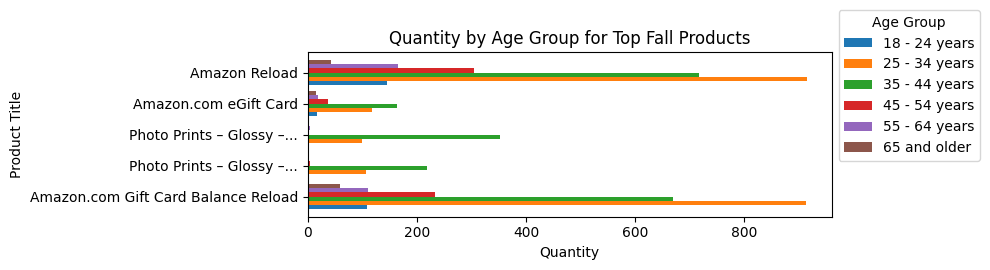

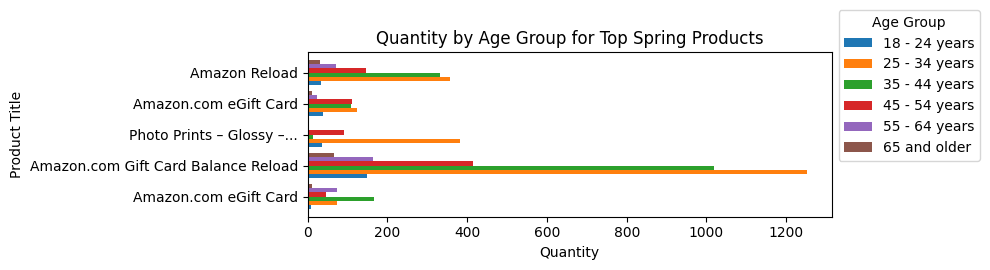

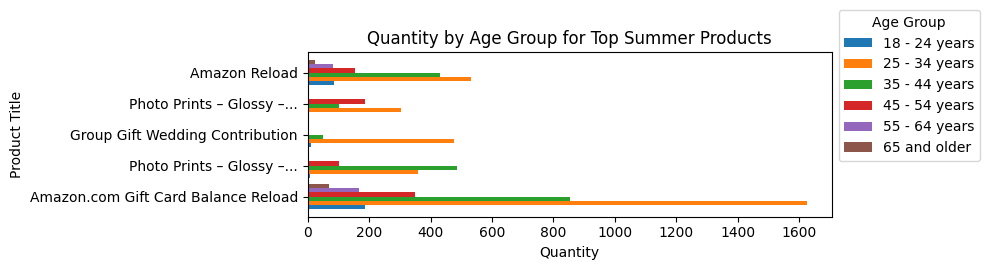

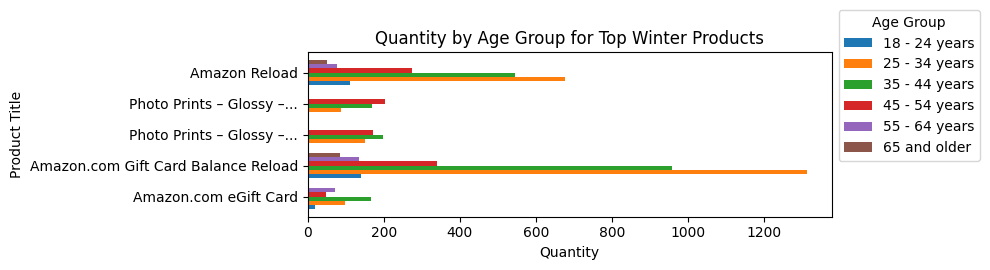

In [21]:
# Age | Quantity | Chart

for season, age_qty_df in age_qty.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        age_qty_df,
        value_type="Quantity",
        demographic="Age Group"
    )
    # override the title to include the season
    ax.set_title(f"Quantity by Age Group for Top {season} Products")
    plt.tight_layout()
    plt.show()

# Income Charts

In [22]:
inc_qty, inc_rev = demographic_breakdown_df(df, title_map, top5_qty, top5_rev, demographic="Income Bracket")


---- Fall Demographic Breakdown ----

Quantity by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B00IX1I3G6,318.0,383.0,365.0,409.0,249.0,225.0,145.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,211.0,0.0,11.0,0.0,108.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,11.0,0.0,23.0,127.0,296.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B07PCMWTSG,51.0,125.0,58.0,55.0,29.0,46.0,7.0,Amazon.com eGift Card
B086KKT3RX,374.0,585.0,321.0,305.0,399.0,238.0,65.0,Amazon Reload


Revenue by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B00IX1I3G6,11697.98,5049.83,7927.61,10879.32,8652.12,4519.16,1305.44,Amazon.com Gift Card Balance Reload
B07PCMWTSG,2142.81,7734.58,1672.27,1968.00,1395.92,490.79,120.00,Amazon.com eGift Card
B07PXGQC1Q,5539.77,2905.88,2008.94,2195.91,2244.79,838.99,0.00,Apple AirPods (2nd Generation) Wireless Earbud...
B086KKT3RX,8561.44,6229.74,8281.50,8086.45,7623.17,3603.85,253.67,Amazon Reload
B09BZ4VF5R,250.00,16855.00,5.00,105.00,120.00,0.00,0.00,Amazon.com eGift Card



---- Spring Demographic Breakdown ----

Quantity by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B004LLIKVU,105.0,19.0,58.0,49.0,83.0,62.0,2.0,Amazon.com eGift Card
B00IX1I3G6,389.0,660.0,482.0,525.0,331.0,414.0,261.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,466.0,10.0,2.0,3.0,29.0,0.0,15.0,Photo Prints – Glossy – Standard Size (4x6)
B07PCMWTSG,85.0,109.0,56.0,74.0,49.0,40.0,3.0,Amazon.com eGift Card
B086KKT3RX,170.0,261.0,145.0,146.0,102.0,112.0,39.0,Amazon Reload


Revenue by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B004LLIKVU,2345.30,1070.57,1788.84,1195.53,2925.48,1118.50,3.04,Amazon.com eGift Card
B00IX1I3G6,7755.00,6967.63,11737.89,12242.22,12860.45,12675.98,241.89,Amazon.com Gift Card Balance Reload
B074T91QTZ,2163.00,927.66,2312.00,762.80,25.00,1634.08,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,1830.02,1865.70,2410.01,1812.99,1856.34,731.10,62.29,Amazon.com eGift Card
B086KKT3RX,5131.86,2073.37,4320.09,3772.23,2498.02,2424.41,261.50,Amazon Reload



---- Summer Demographic Breakdown ----

Quantity by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B00IX1I3G6,427.0,610.0,448.0,517.0,583.0,270.0,395.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,296.0,93.0,158.0,156.0,232.0,26.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B071DPM9RD,35.0,0.0,288.0,17.0,197.0,3.0,0.0,Group Gift Wedding Contribution
B079NF2NFW,345.0,114.0,3.0,127.0,7.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,192.0,312.0,190.0,185.0,272.0,101.0,55.0,Amazon Reload


Revenue by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B004LLIKVU,2840.78,2049.77,1841.33,1840.70,1882.48,685.28,0.00,Amazon.com eGift Card
B00IX1I3G6,10104.02,9467.83,13154.38,12239.43,13416.43,5105.30,495.58,Amazon.com Gift Card Balance Reload
B074T91QTZ,2226.00,1182.54,2126.21,1616.00,125.00,2674.00,25.00,Google Play gift code - give the gift of games...
B07PCMWTSG,4280.75,3729.20,2733.34,2727.93,5135.00,1050.57,195.00,Amazon.com eGift Card
B086KKT3RX,6210.06,2966.34,5518.55,4543.36,5143.24,1613.79,101.33,Amazon Reload



---- Winter Demographic Breakdown ----

Quantity by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B004LLIKVU,122.0,56.0,43.0,52.0,57.0,77.0,0.0,Amazon.com eGift Card
B00IX1I3G6,410.0,638.0,454.0,556.0,331.0,345.0,233.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,143.0,143.0,47.0,118.0,61.0,8.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,85.0,0.0,43.0,330.0,2.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,303.0,343.0,340.0,306.0,199.0,193.0,53.0,Amazon Reload


Revenue by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999","Less than $25,000",Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,,,,
B004LLIKVU,2569.48,2558.90,1032.86,1700.37,1303.10,1013.22,0.00,Amazon.com eGift Card
B00IX1I3G6,10038.87,10195.38,11629.27,11818.45,9746.99,6700.50,886.85,Amazon.com Gift Card Balance Reload
B074T91QTZ,3230.00,1200.03,1348.99,1210.48,376.15,1094.95,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,1240.81,1712.88,1800.15,1333.28,1341.11,615.37,37.29,Amazon.com eGift Card
B086KKT3RX,10067.94,4723.35,8504.12,8760.39,4664.94,2950.13,246.84,Amazon Reload


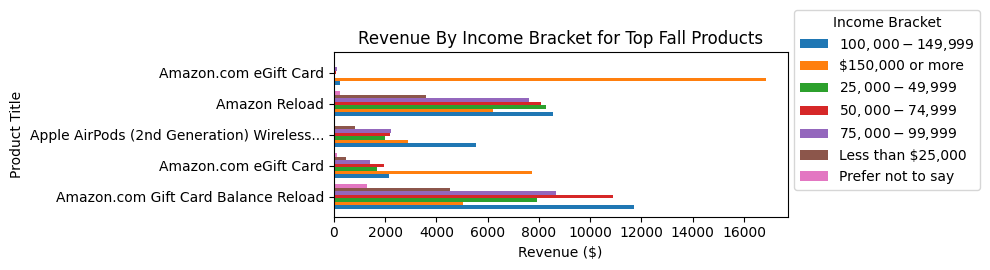

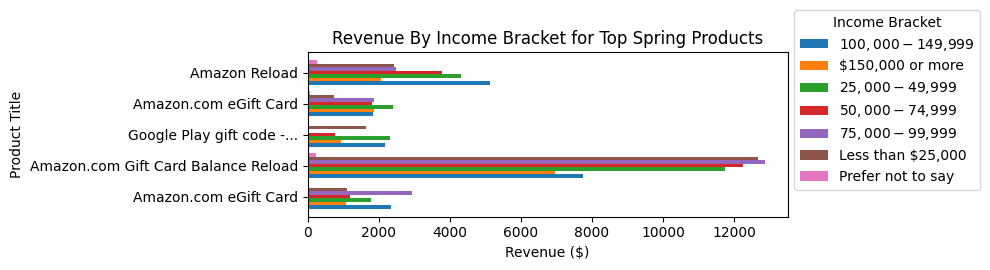

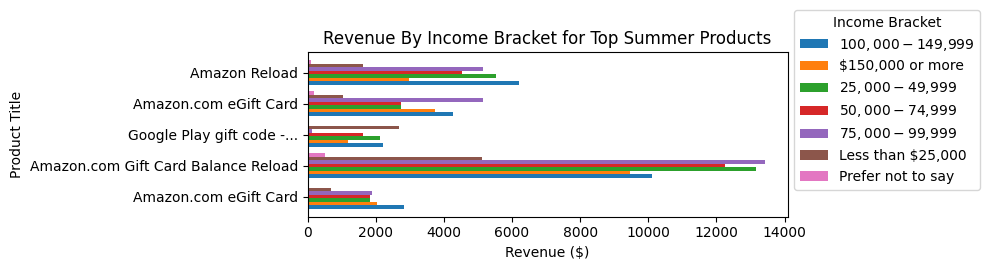

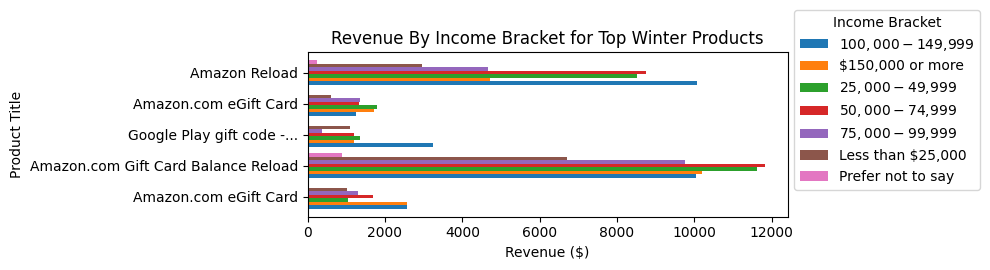

In [23]:
# Income | Revenue | Chart

for season, inc_rev_df in inc_rev.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        inc_rev_df,
        value_type="Revenue",
        demographic="Income Bracket"
    )
    # override the title to include the season
    ax.set_title(f"Revenue By Income Bracket for Top {season} Products")
    plt.tight_layout()
    plt.show()

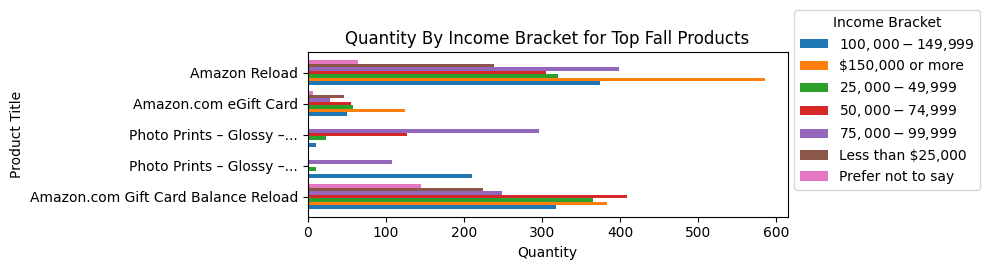

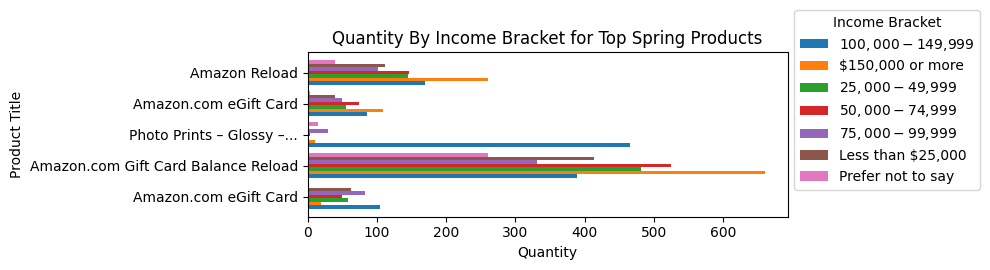

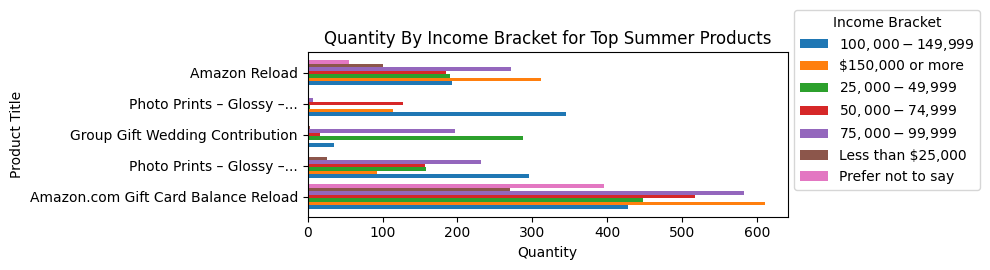

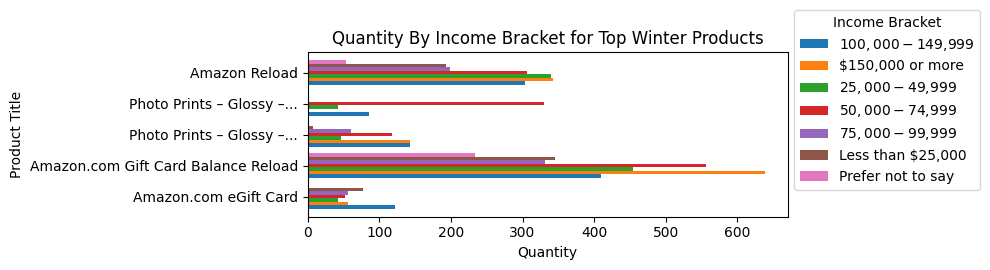

In [24]:
# Income | Quantity | Chart

for season, inc_qty_df in inc_qty.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        inc_qty_df,
        value_type="Quantity",
        demographic="Income Bracket"
    )
    # override the title to include the season
    ax.set_title(f"Quantity By Income Bracket for Top {season} Products")
    plt.tight_layout()
    plt.show()

# Education Charts



In [25]:
edu_qty, edu_rev = demographic_breakdown_df(df, title_map, top5_qty, top5_rev, demographic="Education Level")


---- Fall Demographic Breakdown ----

Quantity by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B00IX1I3G6,959.0,386.0,661.0,13.0,75.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,263.0,67.0,0.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,311.0,134.0,12.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B07PCMWTSG,129.0,46.0,194.0,2.0,0.0,Amazon.com eGift Card
B086KKT3RX,1100.0,538.0,595.0,12.0,42.0,Amazon Reload


Revenue by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B00IX1I3G6,24509.81,9227.38,15147.75,494.31,652.21,Amazon.com Gift Card Balance Reload
B07PCMWTSG,5713.50,1742.12,7943.75,125.00,0.00,Amazon.com eGift Card
B07PXGQC1Q,8886.56,3885.81,2862.91,99.00,0.00,Apple AirPods (2nd Generation) Wireless Earbud...
B086KKT3RX,21905.58,7570.08,11844.65,947.00,372.51,Amazon Reload
B09BZ4VF5R,250.00,32.00,17053.00,0.00,0.00,Amazon.com eGift Card



---- Spring Demographic Breakdown ----

Quantity by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B004LLIKVU,117.0,120.0,140.0,0.0,1.0,Amazon.com eGift Card
B00IX1I3G6,1527.0,591.0,875.0,18.0,51.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,433.0,4.0,88.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B07PCMWTSG,214.0,69.0,129.0,4.0,0.0,Amazon.com eGift Card
B086KKT3RX,420.0,263.0,276.0,2.0,14.0,Amazon Reload


Revenue by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B004LLIKVU,3788.19,3365.67,3292.40,0.00,1.00,Amazon.com eGift Card
B00IX1I3G6,29202.23,8399.33,25334.95,302.94,1241.61,Amazon.com Gift Card Balance Reload
B074T91QTZ,1239.00,427.80,5985.08,172.66,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,3851.62,2818.80,3736.12,161.91,0.00,Amazon.com eGift Card
B086KKT3RX,10217.18,5102.24,4955.89,50.00,156.17,Amazon Reload



---- Summer Demographic Breakdown ----

Quantity by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B00IX1I3G6,1771.0,603.0,831.0,8.0,37.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,602.0,171.0,188.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B071DPM9RD,52.0,145.0,331.0,12.0,0.0,Group Gift Wedding Contribution
B079NF2NFW,278.0,244.0,74.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,658.0,317.0,319.0,2.0,11.0,Amazon Reload


Revenue by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B004LLIKVU,4680.13,3345.03,3109.18,6.00,0.00,Amazon.com eGift Card
B00IX1I3G6,32252.58,11722.00,19683.52,89.03,235.84,Amazon.com Gift Card Balance Reload
B074T91QTZ,1726.00,1558.00,6190.21,475.54,25.00,Google Play gift code - give the gift of games...
B07PCMWTSG,8865.21,4827.76,6033.82,100.00,25.00,Amazon.com eGift Card
B086KKT3RX,15220.55,4321.68,6461.58,11.04,81.82,Amazon Reload



---- Winter Demographic Breakdown ----

Quantity by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B004LLIKVU,128.0,128.0,148.0,3.0,0.0,Amazon.com eGift Card
B00IX1I3G6,1398.0,578.0,917.0,12.0,62.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,132.0,328.0,60.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,7.0,210.0,243.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,788.0,366.0,555.0,3.0,25.0,Amazon Reload


Revenue by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Prefer not to say,Some high school or less,Title
ASIN/ISBN (Product Code),,,,,,
B004LLIKVU,4152.31,3492.82,2468.68,64.12,0.00,Amazon.com eGift Card
B00IX1I3G6,28109.50,11387.96,20577.90,141.67,799.28,Amazon.com Gift Card Balance Reload
B074T91QTZ,2278.00,640.00,5087.57,455.03,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,3376.54,2317.23,2262.12,75.00,50.00,Amazon.com eGift Card
B086KKT3RX,22342.66,5380.80,11834.66,51.04,308.55,Amazon Reload


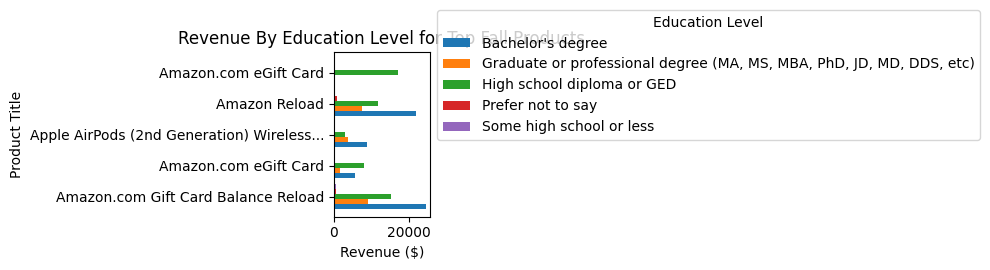

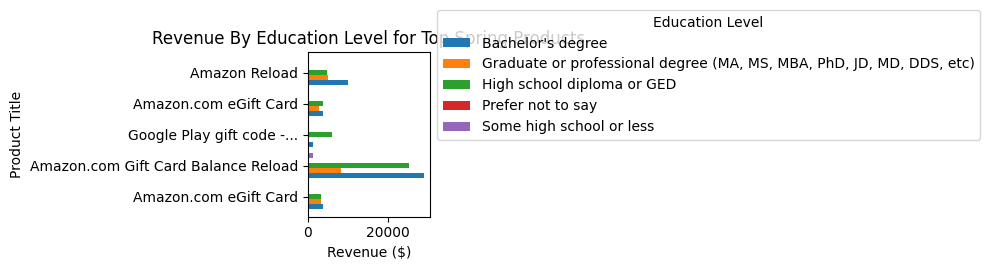

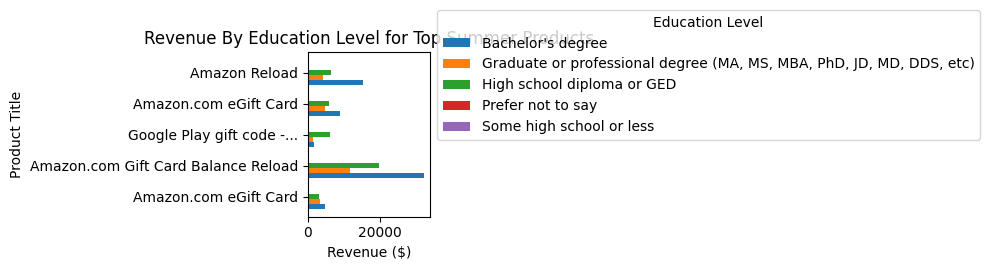

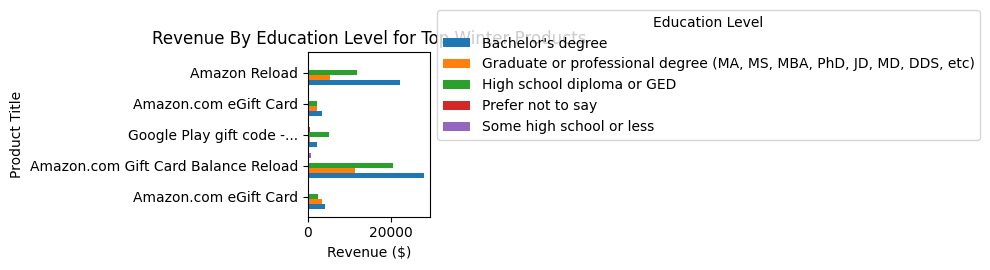

In [26]:
# Education | Revenue | Chart

for season, edu_rev_df in edu_rev.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        edu_rev_df,
        value_type="Revenue",
        demographic="Education Level"
    )
    # override the title to include the season
    ax.set_title(f"Revenue By Education Level for Top {season} Products")
    plt.tight_layout()
    plt.show()

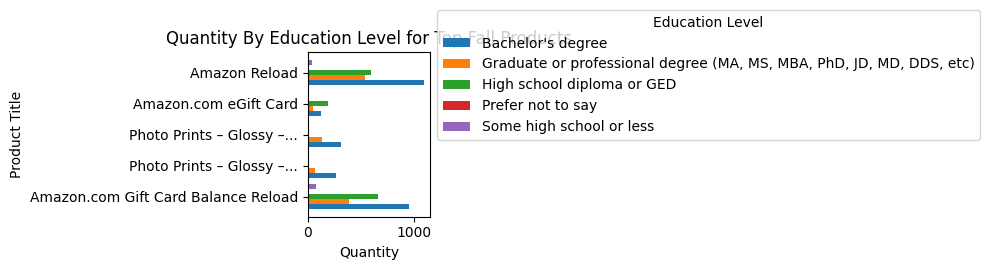

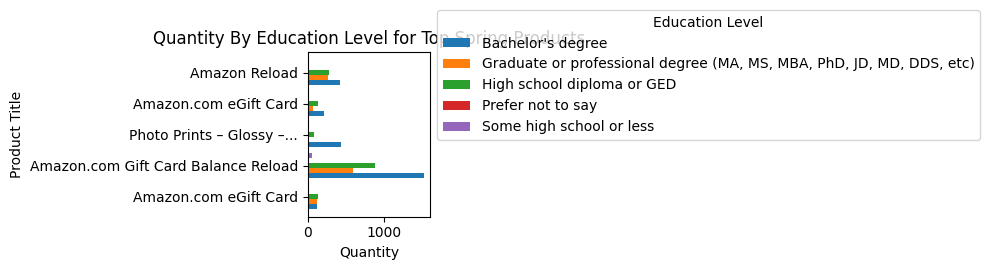

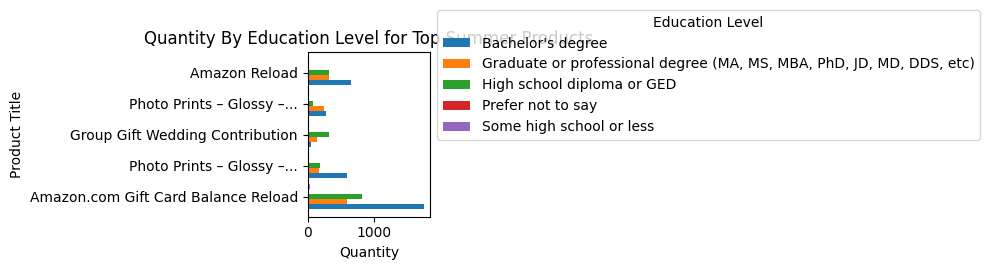

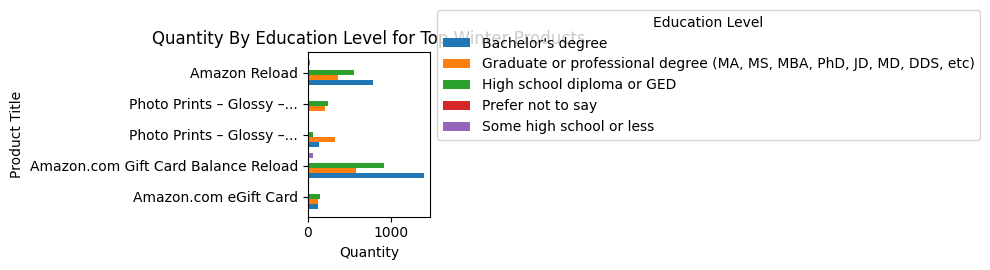

In [27]:
# Education | Quantity | Chart


for season, edu_qty_df in edu_qty.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        edu_qty_df,
        value_type="Quantity",
        demographic="Education Level"
    )
    # override the title to include the season
    ax.set_title(f"Quantity By Education Level for Top {season} Products")
    plt.tight_layout()
    plt.show()

# Gender Charts

In [28]:
gender_qty, gender_rev = demographic_breakdown_df(df, title_map, top5_qty, top5_rev, demographic="Gender")


---- Fall Demographic Breakdown ----

Quantity by Gender:


Q-demos-gender,Female,Male,Other,Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,
B00IX1I3G6,688.0,1400.0,5.0,1.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,287.0,43.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,417.0,16.0,24.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B07PCMWTSG,129.0,237.0,5.0,0.0,Amazon.com eGift Card
B086KKT3RX,835.0,1442.0,10.0,0.0,Amazon Reload


Revenue by Gender:


Q-demos-gender,Female,Male,Other,Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,
B00IX1I3G6,18098.43,31714.67,199.49,18.87,Amazon.com Gift Card Balance Reload
B07PCMWTSG,4349.76,10702.55,472.06,0.00,Amazon.com eGift Card
B07PXGQC1Q,8651.57,7082.71,0.00,0.00,Apple AirPods (2nd Generation) Wireless Earbud...
B086KKT3RX,19003.86,23523.25,112.71,0.00,Amazon Reload
B09BZ4VF5R,280.00,17055.00,0.00,0.00,Amazon.com eGift Card



---- Spring Demographic Breakdown ----

Quantity by Gender:


Q-demos-gender,Female,Male,Other,Title
ASIN/ISBN (Product Code),,,,
B004LLIKVU,130.0,247.0,1.0,Amazon.com eGift Card
B00IX1I3G6,892.0,2158.0,12.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,55.0,470.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B07PCMWTSG,170.0,242.0,4.0,Amazon.com eGift Card
B086KKT3RX,379.0,595.0,1.0,Amazon Reload


Revenue by Gender:


Q-demos-gender,Female,Male,Other,Title
ASIN/ISBN (Product Code),,,,
B004LLIKVU,3288.56,7155.75,2.95,Amazon.com eGift Card
B00IX1I3G6,24988.55,38947.65,544.86,Amazon.com Gift Card Balance Reload
B074T91QTZ,4218.74,3605.80,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,4785.95,5670.97,111.53,Amazon.com eGift Card
B086KKT3RX,9284.20,11193.28,4.00,Amazon Reload



---- Summer Demographic Breakdown ----

Quantity by Gender:


Q-demos-gender,Female,Male,Other,Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,
B00IX1I3G6,917.0,2318.0,14.0,1.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,484.0,460.0,17.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B071DPM9RD,539.0,1.0,0.0,0.0,Group Gift Wedding Contribution
B079NF2NFW,268.0,328.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,434.0,864.0,9.0,0.0,Amazon Reload


Revenue by Gender:


Q-demos-gender,Female,Male,Other,Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,
B004LLIKVU,2783.70,8188.41,168.23,0.00,Amazon.com eGift Card
B00IX1I3G6,24420.60,39191.20,366.66,4.51,Amazon.com Gift Card Balance Reload
B074T91QTZ,3590.54,6384.21,0.00,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,5272.46,14351.86,227.47,0.00,Amazon.com eGift Card
B086KKT3RX,10771.91,15155.18,169.58,0.00,Amazon Reload



---- Winter Demographic Breakdown ----

Quantity by Gender:


Q-demos-gender,Female,Male,Other,Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,
B004LLIKVU,128.0,275.0,4.0,0.0,Amazon.com eGift Card
B00IX1I3G6,977.0,1960.0,26.0,4.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,396.0,124.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,458.0,2.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,683.0,1039.0,14.0,1.0,Amazon Reload


Revenue by Gender:


Q-demos-gender,Female,Male,Other,Prefer not to say,Title
ASIN/ISBN (Product Code),,,,,
B004LLIKVU,2779.66,7294.84,103.43,0.00,Amazon.com eGift Card
B00IX1I3G6,23957.04,36373.88,556.51,128.88,Amazon.com Gift Card Balance Reload
B074T91QTZ,3757.98,4702.62,0.00,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,3824.65,4034.22,222.02,0.00,Amazon.com eGift Card
B086KKT3RX,18973.94,20543.55,375.22,25.00,Amazon Reload


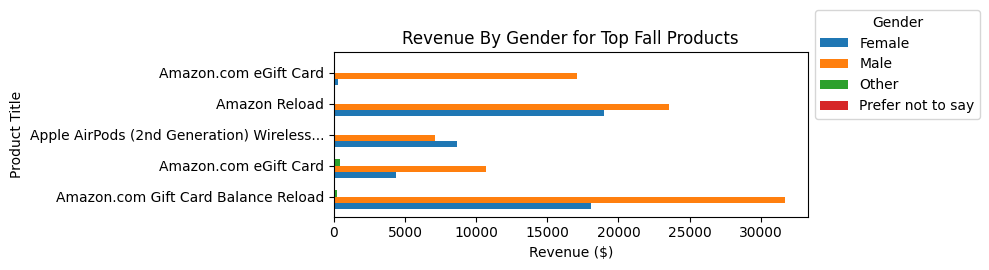

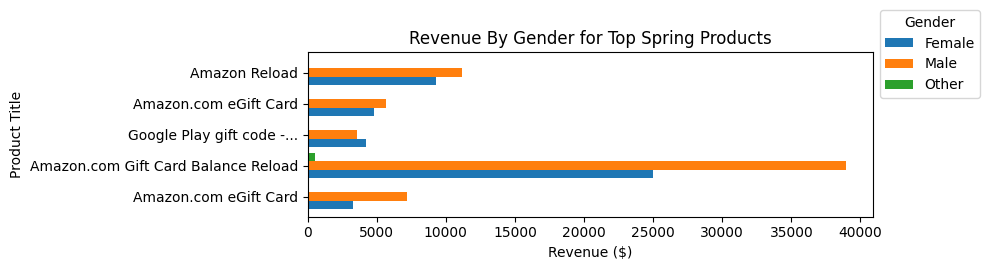

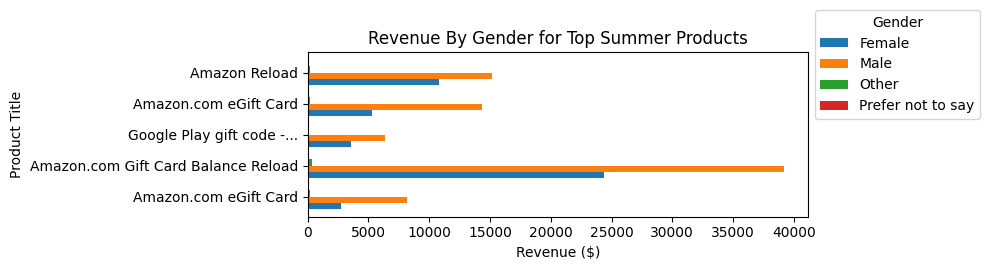

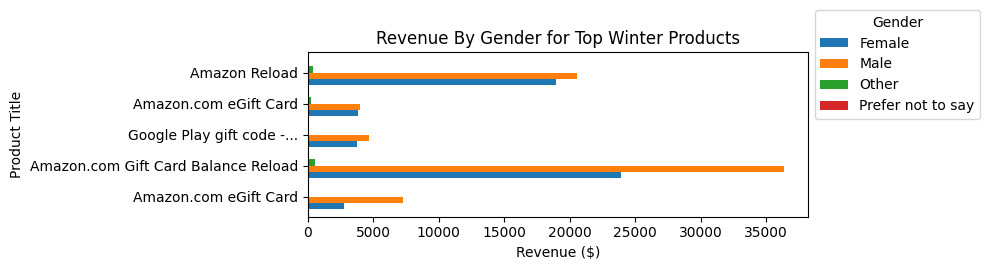

In [29]:
# Gender | Revenue | Chart


for season, gender_rev_df in gender_rev.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        gender_rev_df,
        value_type="Revenue",
        demographic="Gender"
    )
    # override the title to include the season
    ax.set_title(f"Revenue By Gender for Top {season} Products")
    plt.tight_layout()
    plt.show()

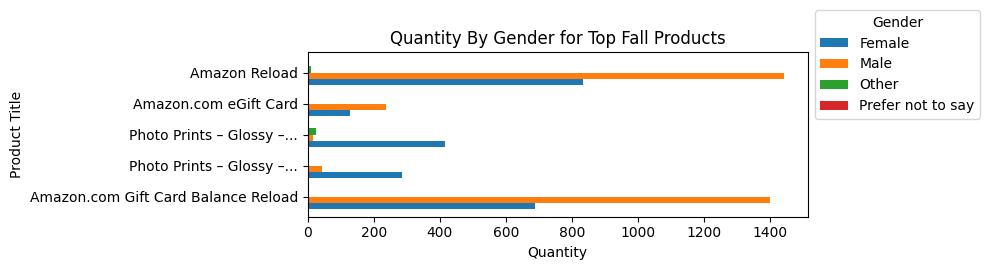

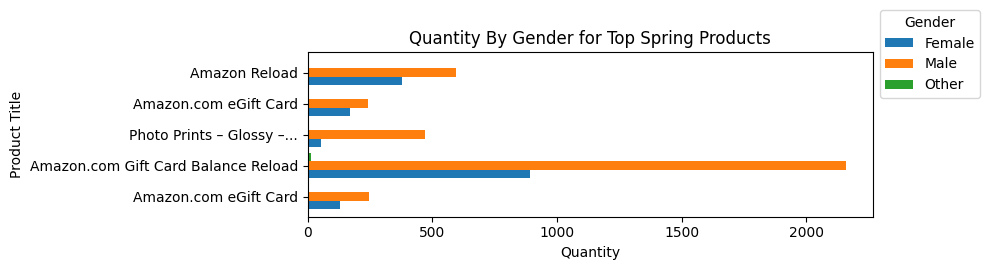

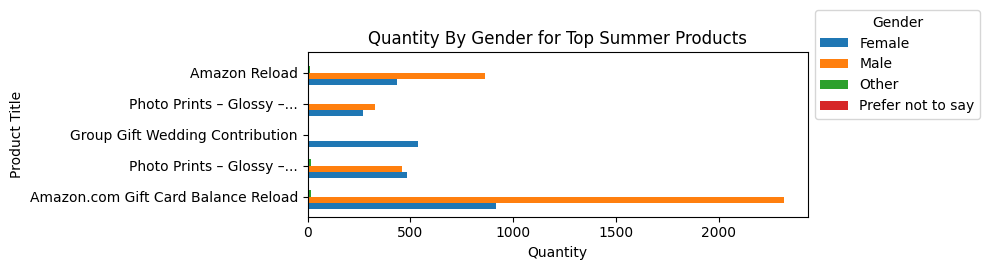

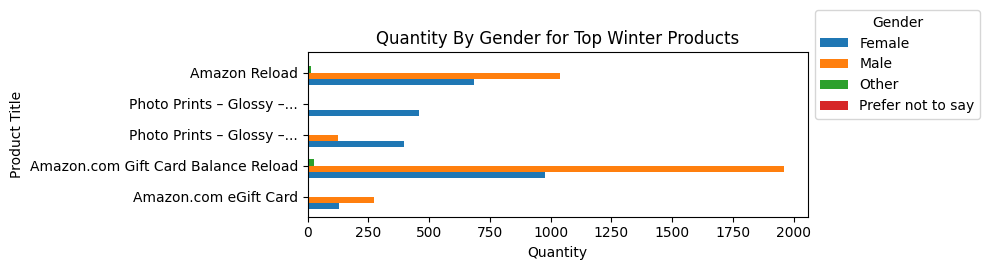

In [30]:
# Gender | Quantity | Chart

for season, gender_qty_df in gender_qty.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        gender_qty_df,
        value_type="Quantity",
        demographic="Gender"
    )
    # override the title to include the season
    ax.set_title(f"Quantity By Gender for Top {season} Products")
    plt.tight_layout()
    plt.show()

# Sexual Orientation Charts

In [31]:
sexual_orientation_qty, sexual_orientation_rev = demographic_breakdown_df(df, title_map, top5_qty, top5_rev, demographic="Sexual Orientation")


---- Fall Demographic Breakdown ----

Quantity by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B00IX1I3G6,281.0,1804.0,9.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,17.0,313.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,24.0,433.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B07PCMWTSG,78.0,293.0,0.0,Amazon.com eGift Card
B086KKT3RX,281.0,1991.0,15.0,Amazon Reload


Revenue by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B00IX1I3G6,7441.40,41319.17,1270.89,Amazon.com Gift Card Balance Reload
B07PCMWTSG,2351.46,13172.91,0.00,Amazon.com eGift Card
B07PXGQC1Q,1628.97,13762.32,342.99,Apple AirPods (2nd Generation) Wireless Earbud...
B086KKT3RX,4886.74,37068.12,684.96,Amazon Reload
B09BZ4VF5R,5.00,17330.00,0.00,Amazon.com eGift Card



---- Spring Demographic Breakdown ----

Quantity by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B004LLIKVU,22.0,355.0,1.0,Amazon.com eGift Card
B00IX1I3G6,360.0,2681.0,21.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,354.0,171.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B07PCMWTSG,67.0,347.0,2.0,Amazon.com eGift Card
B086KKT3RX,134.0,835.0,6.0,Amazon Reload


Revenue by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B004LLIKVU,700.02,9697.24,50.00,Amazon.com eGift Card
B00IX1I3G6,13410.32,48790.91,2279.83,Amazon.com Gift Card Balance Reload
B074T91QTZ,2053.08,5771.46,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,1560.21,8932.33,75.91,Amazon.com eGift Card
B086KKT3RX,3276.73,16770.02,434.73,Amazon Reload



---- Summer Demographic Breakdown ----

Quantity by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B00IX1I3G6,356.0,2875.0,19.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,299.0,662.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B071DPM9RD,329.0,211.0,0.0,Group Gift Wedding Contribution
B079NF2NFW,274.0,322.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,133.0,1171.0,3.0,Amazon Reload


Revenue by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B004LLIKVU,1181.19,9959.15,0.00,Amazon.com eGift Card
B00IX1I3G6,9711.59,51133.75,3137.63,Amazon.com Gift Card Balance Reload
B074T91QTZ,1096.00,8878.75,0.00,Google Play gift code - give the gift of games...
B07PCMWTSG,3326.16,16485.63,40.00,Amazon.com eGift Card
B086KKT3RX,3555.77,22145.90,395.00,Amazon Reload



---- Winter Demographic Breakdown ----

Quantity by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B004LLIKVU,37.0,369.0,1.0,Amazon.com eGift Card
B00IX1I3G6,382.0,2571.0,14.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,7.0,513.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,2.0,458.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,210.0,1496.0,31.0,Amazon Reload


Revenue by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B004LLIKVU,973.91,9179.02,25.00,Amazon.com eGift Card
B00IX1I3G6,10780.98,49087.97,1147.36,Amazon.com Gift Card Balance Reload
B074T91QTZ,856.10,7566.50,38.00,Google Play gift code - give the gift of games...
B07PCMWTSG,1287.16,6729.51,64.22,Amazon.com eGift Card
B086KKT3RX,4913.58,33790.04,1214.09,Amazon Reload


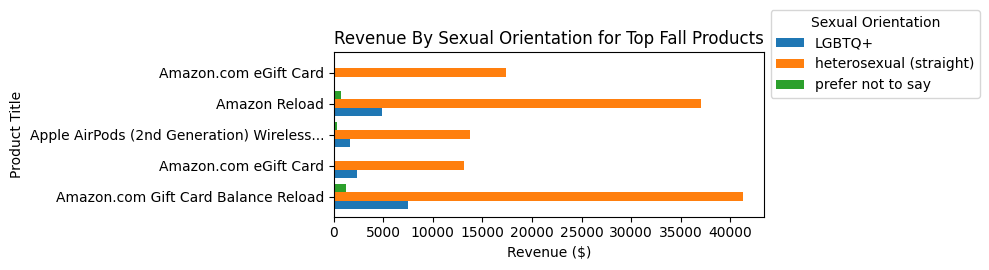

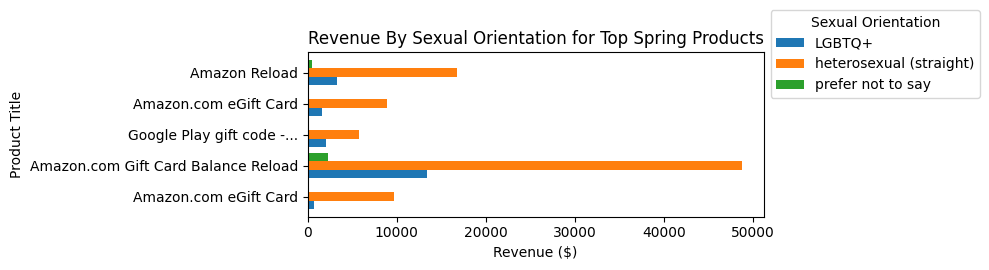

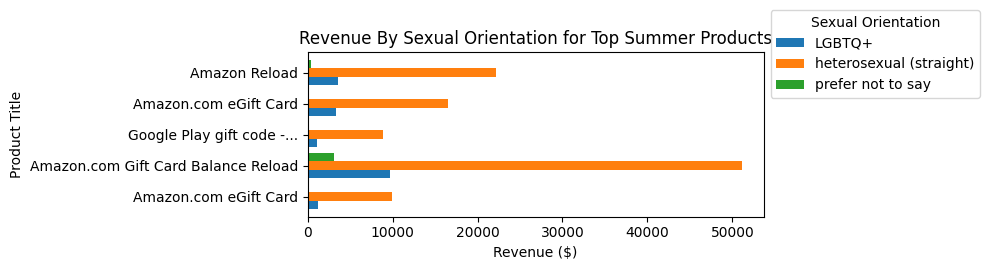

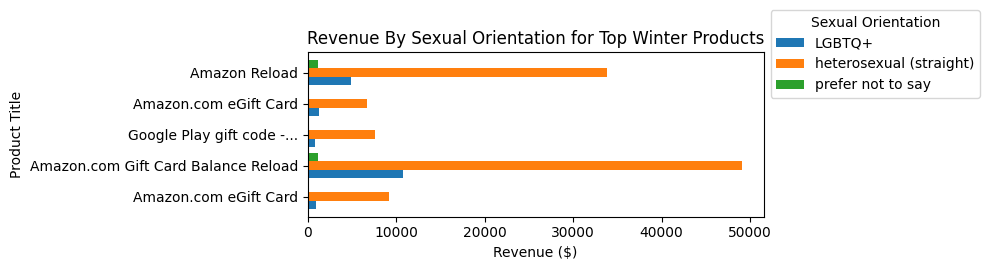

In [32]:
# Sexual Orientation | Revenue | Chart

for season, sexual_orientation_rev_df in sexual_orientation_rev.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        sexual_orientation_rev_df,
        value_type="Revenue",
        demographic="Sexual Orientation"
    )
    # override the title to include the season
    ax.set_title(f"Revenue By Sexual Orientation for Top {season} Products")
    plt.tight_layout()
    plt.show()

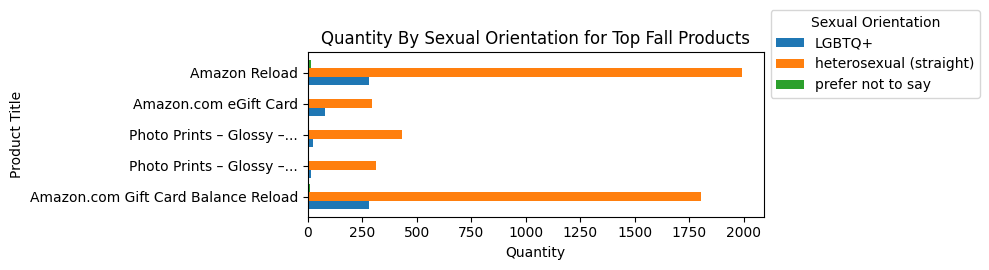

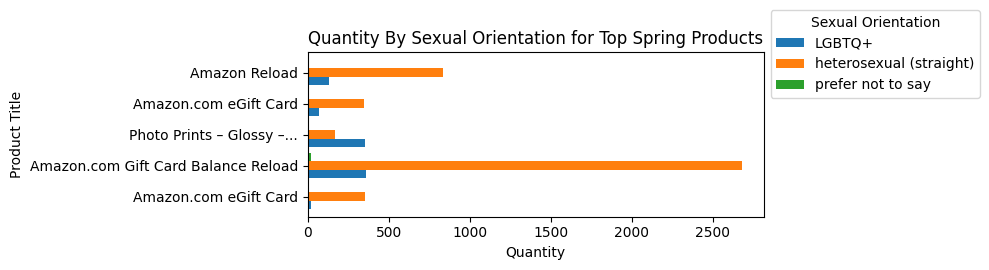

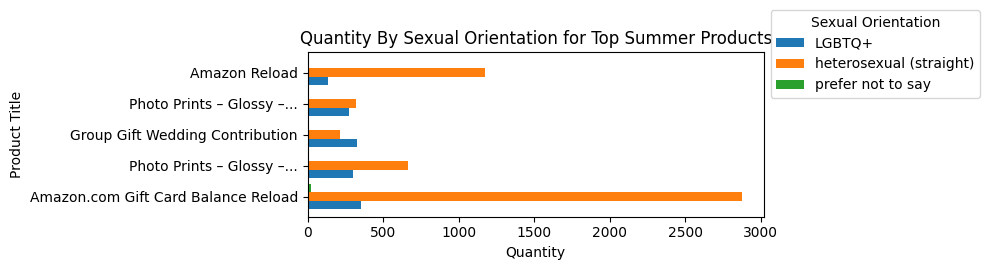

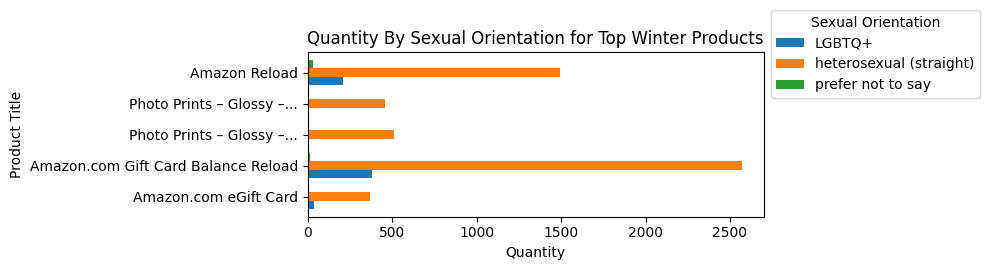

In [33]:
# Sexual Orientation | Quantity | Chart

for season, sexual_orientation_qty_df in sexual_orientation_qty.items():
    # create the figure/axes
    fig, ax = plot_by_group(
        sexual_orientation_qty_df,
        value_type="Quantity",
        demographic="Sexual Orientation"
    )
    # override the title to include the season
    ax.set_title(f"Quantity By Sexual Orientation for Top {season} Products")
    plt.tight_layout()
    plt.show()

# State Charts

In [34]:
state_qty, state_rev = demographic_breakdown_df(df, title_map, top5_qty, top5_rev, demographic="State")


---- Fall Demographic Breakdown ----

Quantity by State:


Q-demos-state,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,...,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B00IX1I3G6,14.0,5.0,9.0,21.0,189.0,14.0,23.0,5.0,2.0,146.0,...,49.0,109.0,13.0,3.0,44.0,47.0,2.0,65.0,0.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,5.0,0.0,140.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,32.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,0.0,0.0,0.0,0.0,28.0,0.0,0.0,0.0,0.0,0.0,...,0.0,23.0,99.0,0.0,0.0,0.0,0.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B07PCMWTSG,3.0,1.0,4.0,1.0,107.0,6.0,3.0,0.0,1.0,23.0,...,30.0,18.0,0.0,0.0,13.0,9.0,0.0,4.0,0.0,Amazon.com eGift Card
B086KKT3RX,25.0,7.0,28.0,14.0,268.0,9.0,5.0,2.0,2.0,169.0,...,45.0,134.0,15.0,3.0,19.0,14.0,3.0,57.0,2.0,Amazon Reload


Revenue by State:


Q-demos-state,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,...,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B00IX1I3G6,597.10,665.03,197.31,222.67,7950.62,596.38,856.8,80.0,20.00,3532.68,...,1361.24,2411.01,158.00,492.00,1726.70,1964.89,34.30,542.58,0.0,Amazon.com Gift Card Balance Reload
B07PCMWTSG,222.06,50.00,80.00,50.00,6338.53,305.00,9.0,0.0,50.00,984.82,...,452.06,682.29,0.00,0.00,171.03,500.00,0.00,122.79,0.0,Amazon.com eGift Card
B07PXGQC1Q,144.00,0.00,0.00,0.00,1144.91,0.00,0.0,0.0,223.95,393.98,...,327.99,1191.92,208.00,0.00,2130.93,144.00,258.99,481.99,0.0,Apple AirPods (2nd Generation) Wireless Earbud...
B086KKT3RX,973.70,76.10,444.00,249.61,5430.07,301.00,141.3,19.0,45.00,4204.41,...,615.72,2624.78,676.74,37.51,993.52,498.03,36.22,897.85,65.0,Amazon Reload
B09BZ4VF5R,0.00,0.00,0.00,0.00,16802.00,0.00,0.0,0.0,0.00,0.00,...,0.00,33.00,0.00,0.00,0.00,220.00,0.00,100.00,0.0,Amazon.com eGift Card



---- Spring Demographic Breakdown ----

Quantity by State:


Q-demos-state,Alabama,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,Georgia,...,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B004LLIKVU,2.0,2.0,0.0,21.0,13.0,52.0,0.0,1.0,12.0,5.0,...,0.0,7.0,30.0,2.0,0.0,12.0,7.0,0.0,5.0,Amazon.com eGift Card
B00IX1I3G6,16.0,23.0,22.0,240.0,18.0,7.0,7.0,0.0,172.0,224.0,...,2.0,50.0,210.0,13.0,5.0,44.0,43.0,5.0,78.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,0.0,339.0,0.0,6.0,37.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B07PCMWTSG,4.0,7.0,1.0,63.0,5.0,7.0,0.0,0.0,21.0,69.0,...,0.0,18.0,40.0,2.0,0.0,30.0,7.0,1.0,7.0,Amazon.com eGift Card
B086KKT3RX,13.0,9.0,2.0,78.0,7.0,0.0,2.0,1.0,69.0,30.0,...,0.0,21.0,86.0,14.0,4.0,7.0,4.0,0.0,16.0,Amazon Reload


Revenue by State:


Q-demos-state,Alabama,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,Georgia,...,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B004LLIKVU,42.95,10.00,0.00,870.54,344.20,659.87,0.0,3.00,647.34,144.03,...,0.00,218.00,1199.34,52.82,0.00,261.70,373.64,0.00,21.00,Amazon.com eGift Card
B00IX1I3G6,843.26,442.82,379.00,4919.24,423.66,279.63,68.0,0.00,3884.23,5040.82,...,44.86,2929.94,5037.51,391.46,275.00,1359.51,2055.97,404.02,437.31,Amazon.com Gift Card Balance Reload
B074T91QTZ,0.00,0.00,0.00,415.00,25.00,0.00,0.0,0.00,122.00,0.00,...,0.00,25.00,425.00,0.00,0.00,25.00,25.00,0.00,40.00,Google Play gift code - give the gift of games...
B07PCMWTSG,111.53,291.00,5.00,1613.30,115.00,30.00,0.0,0.00,622.70,587.86,...,0.00,240.00,848.41,325.00,0.00,483.83,209.00,50.00,99.98,Amazon.com eGift Card
B086KKT3RX,439.60,196.00,22.59,2463.09,185.03,0.00,75.0,2.12,1515.72,664.21,...,0.00,440.96,2903.40,195.00,420.59,107.14,178.68,0.00,130.07,Amazon Reload



---- Summer Demographic Breakdown ----

Quantity by State:


Q-demos-state,Alabama,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,Georgia,...,South Carolina,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B00IX1I3G6,18.0,17.0,14.0,487.0,15.0,7.0,8.0,5.0,164.0,142.0,...,12.0,51.0,184.0,10.0,3.0,54.0,45.0,5.0,86.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,0.0,267.0,0.0,21.0,0.0,0.0,0.0,0.0,19.0,0.0,...,0.0,21.0,43.0,19.0,0.0,50.0,0.0,5.0,0.0,Photo Prints – Glossy – Standard Size (4x6)
B071DPM9RD,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,34.0,Group Gift Wedding Contribution
B079NF2NFW,0.0,253.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,2.0,100.0,0.0,0.0,0.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,18.0,23.0,8.0,214.0,5.0,5.0,0.0,0.0,82.0,33.0,...,2.0,20.0,102.0,15.0,2.0,10.0,15.0,0.0,14.0,Amazon Reload


Revenue by State:


Q-demos-state,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,...,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B004LLIKVU,23.23,0.0,17.67,19.80,898.75,217.00,860.49,0.0,0.00,612.41,...,298.56,1006.19,26.80,100.00,519.89,85.00,0.00,0.00,0.0,Amazon.com eGift Card
B00IX1I3G6,1468.25,0.0,1008.01,170.26,7034.09,303.72,283.23,300.0,63.25,3185.29,...,1154.07,4334.52,1121.73,155.00,2424.86,1465.07,145.23,308.28,0.0,Amazon.com Gift Card Balance Reload
B074T91QTZ,0.00,0.0,50.00,25.00,435.00,35.00,0.00,0.0,0.00,353.21,...,250.00,457.00,25.00,0.00,100.00,25.00,0.00,0.00,50.0,Google Play gift code - give the gift of games...
B07PCMWTSG,292.47,25.0,5.00,0.00,1880.65,790.00,179.00,40.0,65.00,1345.95,...,713.00,2015.30,50.00,0.00,2361.74,421.02,50.00,150.00,0.0,Amazon.com eGift Card
B086KKT3RX,963.52,0.0,356.62,339.59,3142.33,57.00,365.00,0.0,0.00,2128.03,...,541.02,2712.49,231.03,48.17,315.59,283.40,0.00,640.85,0.0,Amazon Reload



---- Winter Demographic Breakdown ----

Quantity by State:


Q-demos-state,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,...,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B004LLIKVU,6.0,0.0,1.0,8.0,25.0,8.0,64.0,0.0,0.0,24.0,...,0.0,8.0,22.0,0.0,0.0,12.0,15.0,1.0,7.0,Amazon.com eGift Card
B00IX1I3G6,17.0,5.0,27.0,18.0,240.0,18.0,30.0,2.0,6.0,175.0,...,2.0,50.0,152.0,18.0,4.0,36.0,48.0,0.0,76.0,Amazon.com Gift Card Balance Reload
B0711H8L7V,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,2.0,115.0,6.0,0.0,0.0,0.0,66.0,Photo Prints – Glossy – Standard Size (4x6)
B079NF2NFW,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,3.0,124.0,2.0,0.0,0.0,0.0,0.0,Photo Prints – Glossy – Standard Size (4x5.3)
B086KKT3RX,35.0,0.0,25.0,4.0,146.0,3.0,12.0,2.0,6.0,129.0,...,0.0,30.0,131.0,5.0,5.0,7.0,21.0,2.0,27.0,Amazon Reload


Revenue by State:


Q-demos-state,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,...,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming,Title
ASIN/ISBN (Product Code),,,,,,,,,,,,,,,,,,,,,
B004LLIKVU,118.43,0.00,5.00,201.40,828.89,263.28,1223.77,0.0,0.00,373.76,...,79.90,453.73,0.00,0.00,237.80,595.32,15.00,60.90,0.0,Amazon.com eGift Card
B00IX1I3G6,655.21,607.26,476.85,277.00,8541.42,1108.64,1972.00,50.0,83.00,4247.15,...,1124.04,2496.65,557.36,165.00,1293.12,1643.37,0.00,402.92,0.0,Amazon.com Gift Card Balance Reload
B074T91QTZ,0.00,0.00,0.00,40.00,1680.00,0.00,0.00,0.0,0.00,352.14,...,160.00,350.00,25.00,25.00,154.95,125.00,0.00,120.00,25.0,Google Play gift code - give the gift of games...
B07PCMWTSG,11.23,0.00,0.00,52.25,1248.97,0.00,0.00,0.0,0.00,326.00,...,331.00,458.65,55.00,70.00,136.46,258.13,0.00,0.00,0.0,Amazon.com eGift Card
B086KKT3RX,830.05,0.00,605.64,24.50,3627.61,168.89,529.59,108.0,59.19,2797.32,...,653.98,3310.85,303.70,95.56,165.00,602.17,38.31,826.05,0.0,Amazon Reload


In [35]:
# State | Revenue | Chart

import geopandas as gpd
import plotly.express as px
# mapping stuff cause gpd is silly and can only handle acronyms
_STATE_ABBREV = {
    'Alabama': 'AL', 'Alaska': 'AK', 'Arizona': 'AZ', 'Arkansas': 'AR',
    'California': 'CA', 'Colorado': 'CO', 'Connecticut': 'CT', 'Delaware': 'DE',
    'District of Columbia': 'DC', 'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI',
    'Idaho': 'ID', 'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA',
    'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA', 'Maine': 'ME',
    'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN',
    'Mississippi': 'MS', 'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE',
    'Nevada': 'NV', 'New Hampshire': 'NH', 'New Jersey': 'NJ', 'New Mexico': 'NM',
    'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND', 'Ohio': 'OH',
    'Oklahoma': 'OK', 'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI',
    'South Carolina': 'SC', 'South Dakota': 'SD', 'Tennessee': 'TN', 'Texas': 'TX',
    'Utah': 'UT', 'Vermont': 'VT', 'Virginia': 'VA', 'Washington': 'WA',
    'West Virginia': 'WV', 'Wisconsin': 'WI', 'Wyoming': 'WY'
}

def plot_state_choropleth(state_rev_df, product_code, title_map, value_type=None, season=None):
  try:
      row = state_rev_df.loc[product_code]
  except KeyError:
      raise ValueError(f"Product code {product_code} not found in DataFrame.")
  if value_type is None:
      raise ValueError("Value type not specified.")
  if season is None:
      raise ValueError("Value type not specified.")

  state_values = row.drop(labels=["Title"])
  df_totals = state_values.reset_index()
  df_totals.columns = ["State", "Value"]
  df_totals["Value"] = pd.to_numeric(df_totals["Value"], errors="coerce")
  df_totals["state_code"] = df_totals["State"].map(_STATE_ABBREV)

  fig = px.choropleth(
    df_totals,
    locations="state_code",
    locationmode="USA-states",
    color="Value",
    scope="usa",
    color_continuous_scale="Blues",
    labels={"Value": value_type},
    title=f"{season} | {title_map.get(product_code, product_code)} — {value_type} by State"
    )
  fig.show()

# To change to a certain season, just replace the loop with the season...
for season in season_cols:
  product_codes = state_rev[season].index.tolist()
  for code in product_codes:
    plot_state_choropleth(state_rev[season], code, title_map, value_type="Revenue", season=season)



In [36]:
# State | Quantity | Chart

# To change to a certain season, just replace the loop with the season...
for season in season_cols:
  product_codes = state_qty[season].index.tolist()
  for code in product_codes:
    plot_state_choropleth(state_qty[season], code, title_map, value_type="Quantity", season=season)


# Cleaning Amazon Gift Cards out

Since we've noticed that Amazon gift cards dominate the products, we've decided to do the same analysis without the Amazon gift cards to get a clearer picture.

In [37]:
# This one is by revenue and no gift cards

df_pr = pivot_revenue.copy()
df_pr = df_pr.merge(df[['ASIN/ISBN (Product Code)', 'Title']].drop_duplicates(subset=['ASIN/ISBN (Product Code)']), on='ASIN/ISBN (Product Code)', how='left')

is_gift = (
    df_pr['Title'].str.contains('Amazon', na=False) &
    df_pr['Title'].str.contains('Gift Card', na=False)
)
df_pr['IsGift'] = is_gift

df_no_gift = df_pr[~df_pr['IsGift']].copy()

df_no_gift['CV_SCORE'] = df_no_gift[season_cols].std(axis=1) / df_no_gift[season_cols].mean(axis=1)

df_no_gift = df_no_gift.sort_values('CV_SCORE', ascending=False)
df_no_gift



,ASIN/ISBN (Product Code),Fall,Spring,Summer,Winter,CV_SCORE,Title,IsGift
94610,B0017LQOQU,0.00,0.00,18.49,0.00,2.0,Pierre Cardin by Pierre Cardin for Men - 2.8 o...,False
412101,B077S8NYT1,0.00,0.00,19.94,0.00,2.0,Flipazoo AS Seen On TV Slippers Unicorn Transf...,False
264543,B01CKICB10,20.93,0.00,0.00,0.00,2.0,"Creative Hobbies 3228x25 (25 Pack) - 7C7/CL, 7...",False
264523,B01CKFVJES,0.00,0.00,30.79,0.00,2.0,Red Co. 16 to 28 inch Expandable Steel Metal 6...,False
751515,B08CQMLNZW,0.00,18.99,0.00,0.00,2.0,Evridwear Exfoliating Back Scrubber Heavy Duty...,False
...,...,...,...,...,...,...,...,...
446820,B07BN53LBC,29.99,29.99,29.99,29.99,0.0,NaN,False
38002,1530051126,9.99,9.99,9.99,9.99,0.0,Python for Everybody: Exploring Data in Python 3,False
289200,B01J0WCHFE,19.95,19.95,19.95,19.95,0.0,Magnetic Knife Holder for Wall - Stainless Ste...,False
375062,B074H5J9NF,2.99,2.99,2.99,2.99,0.0,"365 by Whole Foods Market, Haricot Vert Organi...",False


In [38]:
# This one is by quantity and no gift cards
# Uses pivot quantity/revenue because those aren't filtered and will allow for accurate calculations
df_pft = pivot_quantity.copy()
df_pft = df_pft.merge(df[['ASIN/ISBN (Product Code)', 'Title']].drop_duplicates(subset=['ASIN/ISBN (Product Code)']), on='ASIN/ISBN (Product Code)', how='left')
is_gift_qty = (
    df_pft['Title'].str.contains('Amazon', na=False) &
    df_pft['Title'].str.contains('Gift Card', na=False)
)

df_pft['IsGift'] = is_gift_qty
# removes all gift cards labeled as a gift
df_no_gift_pft = df_pft[~df_pft['IsGift']].copy()

df_no_gift_pft['CV_SCORE'] = df_no_gift_pft[season_cols].std(axis=1) / df_no_gift_pft[season_cols].mean(axis=1)

df_no_gift_pft = df_no_gift_pft.sort_values('CV_SCORE', ascending=False)
df_no_gift_pft


,ASIN/ISBN (Product Code),Fall,Spring,Summer,Winter,CV_SCORE,Title,IsGift
939072,BGARED801T,0.0,1.0,0.0,0.0,2.0,"Tegu Swivel Bug Magnetic Building Block Set, P...",False
0,000004458X,1.0,0.0,0.0,0.0,2.0,NaN,False
1,000217653X,2.0,0.0,0.0,0.0,2.0,THE DINAH'S CUPBOARD COOK BOOK: Recipes and Me...,False
2,0002727463,0.0,1.0,0.0,0.0,2.0,The Steel Bonnets: The Story of the Anglo-Scot...,False
3,0004983289,0.0,0.0,1.0,0.0,2.0,NaN,False
...,...,...,...,...,...,...,...,...
459854,B07CS172F5,1.0,1.0,1.0,1.0,0.0,NaN,False
792543,B08LV7YLV7,1.0,1.0,1.0,1.0,0.0,Gimbal Stabilizer for Smartphone with Extendab...,False
129184,B004T4LY8U,1.0,1.0,1.0,1.0,0.0,"Oster BLSTPB-WGN My Blend 250-Watt Blender, Green",False
149395,B008BOX5MC,1.0,1.0,1.0,1.0,0.0,NaN,False


For each product, calculate its implied per‐unit price in each season. Then compute that product’s overall average price and how much its price swings around (CV). Finally, pick out the top-10 priciest products and the top-10 most volatile-priced products, and assemble a table with ASIN, title, all those seasonal prices plus AVG_PRICE and CV_PRICE.

In [53]:
# This one is no giftcards and its a ratio of the quantity / revenue

pivot_qty = df_no_gift_pft[season_cols]
pivot_rev = df_no_gift[season_cols]

ratio_pivot = pivot_rev.div(pivot_qty.replace(0, np.nan))
ratio_pivot = ratio_pivot.replace([np.inf, -np.inf], np.nan).fillna(0)

ratio_pivot['AVG_PRICE'] = (
    pivot_rev.sum(axis=1) / pivot_qty.sum(axis=1)
).replace([np.inf, -np.inf], 0)

ratio_pivot['CV_PRICE'] = ratio_pivot[season_cols].std(axis=1) / ratio_pivot[season_cols].mean(axis=1)

top_price = ratio_pivot.sort_values('AVG_PRICE', ascending=False).head(10)

top_cv_price = ratio_pivot.sort_values('CV_PRICE', ascending=False).head(10)

meta = df_no_gift[['ASIN/ISBN (Product Code)','Title']]
x = 0
full_price = meta.join(ratio_pivot).fillna(x)
full_price



,ASIN/ISBN (Product Code),Title,Fall,Spring,Summer,Winter,AVG_PRICE,CV_PRICE
94610,B0017LQOQU,Pierre Cardin by Pierre Cardin for Men - 2.8 o...,0.000,0.00,18.49,0.00,18.490,2.0
412101,B077S8NYT1,Flipazoo AS Seen On TV Slippers Unicorn Transf...,0.000,0.00,19.94,0.00,19.940,2.0
264543,B01CKICB10,"Creative Hobbies 3228x25 (25 Pack) - 7C7/CL, 7...",10.465,0.00,0.00,0.00,10.465,2.0
264523,B01CKFVJES,Red Co. 16 to 28 inch Expandable Steel Metal 6...,0.000,0.00,30.79,0.00,30.790,2.0
751515,B08CQMLNZW,Evridwear Exfoliating Back Scrubber Heavy Duty...,0.000,18.99,0.00,0.00,18.990,2.0
...,...,...,...,...,...,...,...,...
446820,B07BN53LBC,0,29.990,29.99,29.99,29.99,29.990,0.0
38002,1530051126,Python for Everybody: Exploring Data in Python 3,9.990,9.99,9.99,9.99,9.990,0.0
289200,B01J0WCHFE,Magnetic Knife Holder for Wall - Stainless Ste...,19.950,19.95,19.95,19.95,19.950,0.0
375062,B074H5J9NF,"365 by Whole Foods Market, Haricot Vert Organi...",2.990,2.99,2.99,2.99,2.990,0.0


from matplotlib import pyplot as plt
full_price['Fall'].plot(kind='hist', bins=20, title='Fall')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price['Spring'].plot(kind='hist', bins=20, title='Spring')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price['Summer'].plot(kind='hist', bins=20, title='Summer')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price['Winter'].plot(kind='hist', bins=20, title='Winter')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price.plot(kind='scatter', x='Fall', y='Spring', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price.plot(kind='scatter', x='Spring', y='Summer', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price.plot(kind='scatter', x='Summer', y='Winter', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price.plot(kind='scatter', x='Winter', y='AVG_PRICE', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
full_price['Fall'].plot(kind='line', figsize=(8, 4), title='Fall')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
full_price['Spring'].plot(kind='line', figsize=(8, 4), title='Spring')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
full_price['Summer'].plot(kind='line', figsize=(8, 4), title='Summer')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
full_price['Winter'].plot(kind='line', figsize=(8, 4), title='Winter')
plt.gca().spines[['top', 'right']].set_visible(False)

In [50]:
# Top 5 by ratio

fp = full_price.copy().reset_index()

melted = fp.melt(
    id_vars=["ASIN/ISBN (Product Code)", "Title", "AVG_PRICE"],
    value_vars=season_cols,
    var_name="Season",
    value_name="Seasonal Price",
)

melted["Sea_to_Avg"] = melted["Seasonal Price"] / melted["AVG_PRICE"]

top_by_ratio = (
    melted
      .groupby("Season", group_keys=False)
      .apply(lambda df: df.nlargest(5, "Sea_to_Avg"))
      .reset_index(drop=True)
)

top_by_ratio # This grabs top 5 per season

<ipython-input-50-8428e50fd494>:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,ASIN/ISBN (Product Code),Title,AVG_PRICE,Season,Seasonal Price,Sea_to_Avg
0,B005KCIHTY,Organic Pink Lady Apples,2.043226,Fall,7.150000,3.499368
1,B0012NLMP6,"Red Vines Licorice, Original Red Flavor, 5oz T...",1.810000,Fall,6.210000,3.430939
2,B0788QSYHV,Organic Japanese Sweet Potato,2.973333,Fall,8.580000,2.885650
3,B086T638CS,"Single Use Disposable Face Mask (Pack of 50), ...",4.240000,Fall,12.156667,2.867138
4,B0039LF25A,Garden of Life Oceans Mom Prenatal Fish Oil DH...,5.132857,Fall,14.690000,2.861954
5,B001GIP5CI,Organic Gala Apples,1.958947,Spring,8.760000,4.471789
6,B086Y1S8C8,"3 Ply Disposable Protective Mask, 50 Masks in ...",8.270000,Spring,34.990000,4.230955
7,B07DK2P8P7,Nioh 2 - PlayStation 4,18.545714,Spring,59.880000,3.228778
8,B084Z5QW9C,GNC Vitamin C 1000 mg | Provides Immune Suppor...,6.390000,Spring,19.990000,3.128326
9,B0868YY9MW,"SUNCOO Face Mask, Pack of 50 - Disposable Face...",12.024000,Spring,37.020000,3.078842


**Creating the charts by the ratio and with no gift cards...**

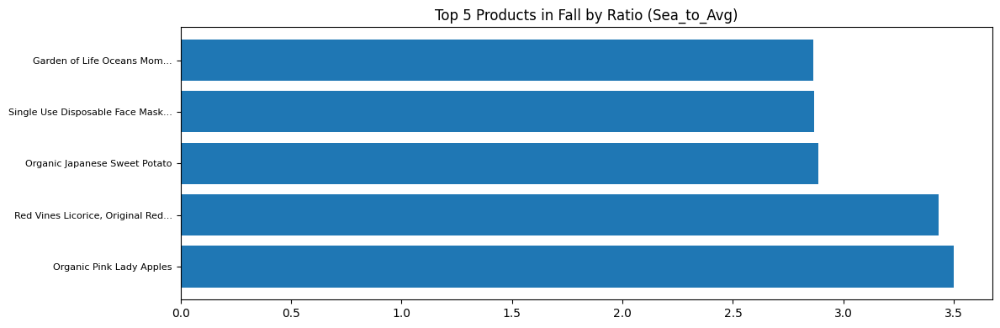

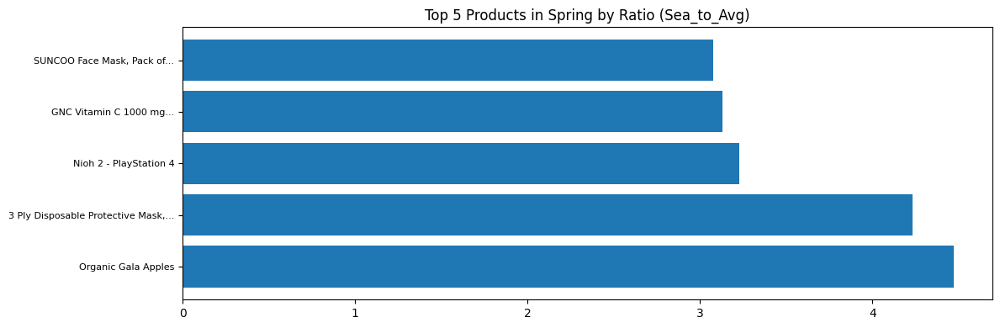

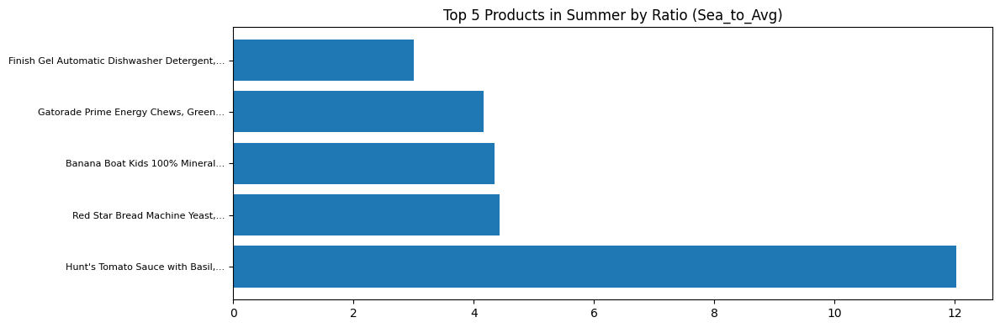

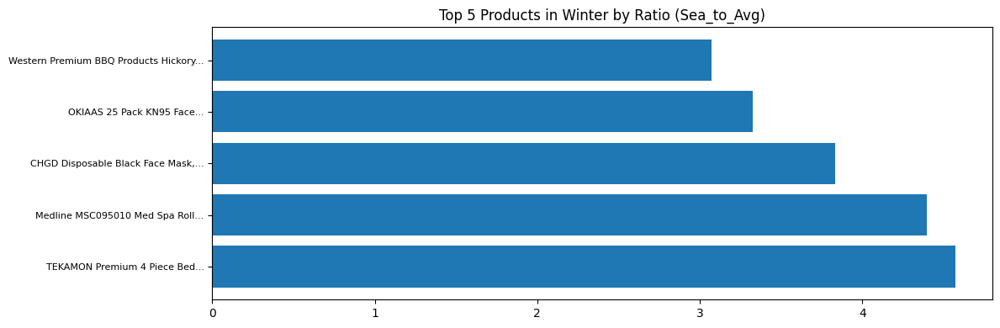

In [41]:
set_bars = 5 # If you happen to take more products above and they have the same name, you need to adjust this as well
for season in season_cols:
  y = np.arange(set_bars)

  top_5_by_ratio = top_by_ratio[top_by_ratio['Season'] == season].copy()

  top_5_by_ratio['ShortTitle'] = top_5_by_ratio['Title'].apply(lambda t: truncate_title(t, n_words=5))

  fig, ax = plt.subplots(ncols=1, figsize=(12,4))
  ax.barh(y, top_5_by_ratio['Sea_to_Avg'], height=0.8)
  ax.set_yticks(y)
  ax.set_yticklabels(top_5_by_ratio['ShortTitle'], fontsize=8)
  ax.set_title(f"Top 5 Products in {season} by Ratio (Sea_to_Avg)")

  fig.tight_layout()
  plt.show()

In [42]:
def demographic_breakdown_ratio(df, title_map, top5_ratio, demographic=None) -> typ.Tuple[pd.DataFrame, pd.DataFrame]:
  '''
  Creates the demographic break down by ratio for each season/demographic
  '''
  demographic_column_label = get_column_label_for_demographic(demographic)
  ratio_by_szn = {}

  for season in season_cols:
    print(f"\n---- {season} Demographic Breakdown ----\n")
    top_asins_ratio = top5_ratio[top5_ratio['Season']==season]['ASIN/ISBN (Product Code)']
    df_season_ratio = df[(df['Season']==season) & df['ASIN/ISBN (Product Code)'].isin(top_asins_ratio)].copy()

    df_season_ratio = df_season_ratio.merge(
            top5_ratio[top5_ratio['Season']==season][
                ['ASIN/ISBN (Product Code)','Sea_to_Avg']
            ],
            on='ASIN/ISBN (Product Code)',
            how='left'
        )
    d_ratio = (
          df_season_ratio
          .groupby(['ASIN/ISBN (Product Code)', demographic_column_label])['Sea_to_Avg']
          .sum()
          .unstack(fill_value=0)
      )

    d_ratio['Title'] = d_ratio.index.map(title_map)

    print(f"Ratio by {demographic}:")
    display(d_ratio)

    ratio_by_szn[season] = d_ratio

  return ratio_by_szn

col_lookup = {
      "Age Group": "Q-demos-age",
      "Income Bracket": "Q-demos-income",
      "Gender": "Q-demos-gender",
      "Sexual Orientation": "Q-sexual-orientation",
      "Education Level": "Q-demos-education",
      "State": "Q-demos-state"
}
demographic_stats = {}
for col in col_lookup:
  demographic_stats[col] = demographic_breakdown_ratio(df, title_map, top_by_ratio, demographic=col)





---- Fall Demographic Breakdown ----

Ratio by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,Title
ASIN/ISBN (Product Code),,,,
B0012NLMP6,0.00000,3.430939,0.000000,"Red Vines Licorice, Original Red Flavor, 5oz T..."
B0039LF25A,0.00000,0.000000,2.861954,Garden of Life Oceans Mom Prenatal Fish Oil DH...
B005KCIHTY,0.00000,0.000000,6.998737,Organic Pink Lady Apples
B0788QSYHV,2.88565,0.000000,0.000000,Organic Japanese Sweet Potato
B086T638CS,0.00000,8.601415,0.000000,"Single Use Disposable Face Mask (Pack of 50), ..."



---- Spring Demographic Breakdown ----

Ratio by Age Group:


Q-demos-age,25 - 34 years,35 - 44 years,45 - 54 years,65 and older,Title
ASIN/ISBN (Product Code),,,,,
B001GIP5CI,0.000000,4.471789,0.000000,0.000000,Organic Gala Apples
B07DK2P8P7,3.228778,0.000000,0.000000,0.000000,Nioh 2 - PlayStation 4
B084Z5QW9C,0.000000,0.000000,0.000000,3.128326,GNC Vitamin C 1000 mg | Provides Immune Suppor...
B0868YY9MW,0.000000,0.000000,3.078842,0.000000,"SUNCOO Face Mask, Pack of 50 - Disposable Face..."
B086Y1S8C8,4.230955,0.000000,0.000000,0.000000,"3 Ply Disposable Protective Mask, 50 Masks in ..."



---- Summer Demographic Breakdown ----

Ratio by Age Group:


Q-demos-age,35 - 44 years,45 - 54 years,Title
ASIN/ISBN (Product Code),,,
B000V9OVLO,0.000000,12.022938,"Hunt's Tomato Sauce with Basil, Garlic, and Or..."
B000VDX2IS,3.010050,0.000000,"Finish Gel Automatic Dishwasher Detergent, Lem..."
B002CIP40E,0.000000,4.425434,"Red Star Bread Machine Yeast, 4 oz"
B00UA9G69U,4.166319,0.000000,"Gatorade Prime Energy Chews, Green Apple - 1 O..."
B077HRZXVK,4.338898,0.000000,Banana Boat Kids 100% Mineral Sunscreen Lotion...



---- Winter Demographic Breakdown ----

Ratio by Age Group:


Q-demos-age,18 - 24 years,25 - 34 years,35 - 44 years,Title
ASIN/ISBN (Product Code),,,,
B000K6L198,0.000000,0.000000,4.396419,Medline MSC095010 Med Spa Roll On Antiperspira...
B006OD885G,0.000000,3.073254,0.000000,Western Premium BBQ Products Hickory BBQ Smoki...
B075JGN2HQ,0.000000,0.000000,4.572368,TEKAMON Premium 4 Piece Bed Sheet Set 1800 Thr...
B08TVHLZPX,3.324332,3.324332,6.648663,"OKIAAS 25 Pack KN95 Face Mask, 5-Layer masks d..."
B09JL6Y89Q,0.000000,3.835091,0.000000,"CHGD Disposable Black Face Mask, 5 Layer 3D Cu..."



---- Fall Demographic Breakdown ----

Ratio by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$25,000 - $49,999","$50,000 - $74,999","$75,000 - $99,999",Title
ASIN/ISBN (Product Code),,,,,
B0012NLMP6,3.430939,0.000000,0.000000,0.000000,"Red Vines Licorice, Original Red Flavor, 5oz T..."
B0039LF25A,0.000000,0.000000,0.000000,2.861954,Garden of Life Oceans Mom Prenatal Fish Oil DH...
B005KCIHTY,0.000000,0.000000,0.000000,6.998737,Organic Pink Lady Apples
B0788QSYHV,0.000000,0.000000,0.000000,2.885650,Organic Japanese Sweet Potato
B086T638CS,0.000000,5.734277,2.867138,0.000000,"Single Use Disposable Face Mask (Pack of 50), ..."



---- Spring Demographic Breakdown ----

Ratio by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$150,000 or more","$25,000 - $49,999","$75,000 - $99,999",Title
ASIN/ISBN (Product Code),,,,,
B001GIP5CI,0.000000,4.471789,0.000000,0.000000,Organic Gala Apples
B07DK2P8P7,0.000000,0.000000,0.000000,3.228778,Nioh 2 - PlayStation 4
B084Z5QW9C,0.000000,0.000000,0.000000,3.128326,GNC Vitamin C 1000 mg | Provides Immune Suppor...
B0868YY9MW,0.000000,0.000000,3.078842,0.000000,"SUNCOO Face Mask, Pack of 50 - Disposable Face..."
B086Y1S8C8,4.230955,0.000000,0.000000,0.000000,"3 Ply Disposable Protective Mask, 50 Masks in ..."



---- Summer Demographic Breakdown ----

Ratio by Income Bracket:


Q-demos-income,"$100,000 - $149,999","$25,000 - $49,999","$75,000 - $99,999",Title
ASIN/ISBN (Product Code),,,,
B000V9OVLO,12.022938,0.000000,0.00000,"Hunt's Tomato Sauce with Basil, Garlic, and Or..."
B000VDX2IS,0.000000,0.000000,3.01005,"Finish Gel Automatic Dishwasher Detergent, Lem..."
B002CIP40E,4.425434,0.000000,0.00000,"Red Star Bread Machine Yeast, 4 oz"
B00UA9G69U,4.166319,0.000000,0.00000,"Gatorade Prime Energy Chews, Green Apple - 1 O..."
B077HRZXVK,0.000000,4.338898,0.00000,Banana Boat Kids 100% Mineral Sunscreen Lotion...



---- Winter Demographic Breakdown ----

Ratio by Income Bracket:


Q-demos-income,"$150,000 or more","$25,000 - $49,999","$75,000 - $99,999","Less than $25,000",Title
ASIN/ISBN (Product Code),,,,,
B000K6L198,4.396419,0.000000,0.000000,0.000000,Medline MSC095010 Med Spa Roll On Antiperspira...
B006OD885G,0.000000,0.000000,3.073254,0.000000,Western Premium BBQ Products Hickory BBQ Smoki...
B075JGN2HQ,0.000000,0.000000,0.000000,4.572368,TEKAMON Premium 4 Piece Bed Sheet Set 1800 Thr...
B08TVHLZPX,6.648663,6.648663,0.000000,0.000000,"OKIAAS 25 Pack KN95 Face Mask, 5-Layer masks d..."
B09JL6Y89Q,0.000000,0.000000,3.835091,0.000000,"CHGD Disposable Black Face Mask, 5 Layer 3D Cu..."



---- Fall Demographic Breakdown ----

Ratio by Gender:


Q-demos-gender,Female,Male,Title
ASIN/ISBN (Product Code),,,
B0012NLMP6,3.430939,0.000000,"Red Vines Licorice, Original Red Flavor, 5oz T..."
B0039LF25A,2.861954,0.000000,Garden of Life Oceans Mom Prenatal Fish Oil DH...
B005KCIHTY,6.998737,0.000000,Organic Pink Lady Apples
B0788QSYHV,0.000000,2.885650,Organic Japanese Sweet Potato
B086T638CS,2.867138,5.734277,"Single Use Disposable Face Mask (Pack of 50), ..."



---- Spring Demographic Breakdown ----

Ratio by Gender:


Q-demos-gender,Female,Male,Title
ASIN/ISBN (Product Code),,,
B001GIP5CI,0.000000,4.471789,Organic Gala Apples
B07DK2P8P7,0.000000,3.228778,Nioh 2 - PlayStation 4
B084Z5QW9C,0.000000,3.128326,GNC Vitamin C 1000 mg | Provides Immune Suppor...
B0868YY9MW,3.078842,0.000000,"SUNCOO Face Mask, Pack of 50 - Disposable Face..."
B086Y1S8C8,0.000000,4.230955,"3 Ply Disposable Protective Mask, 50 Masks in ..."



---- Summer Demographic Breakdown ----

Ratio by Gender:


Q-demos-gender,Female,Male,Title
ASIN/ISBN (Product Code),,,
B000V9OVLO,12.022938,0.000000,"Hunt's Tomato Sauce with Basil, Garlic, and Or..."
B000VDX2IS,3.010050,0.000000,"Finish Gel Automatic Dishwasher Detergent, Lem..."
B002CIP40E,0.000000,4.425434,"Red Star Bread Machine Yeast, 4 oz"
B00UA9G69U,4.166319,0.000000,"Gatorade Prime Energy Chews, Green Apple - 1 O..."
B077HRZXVK,0.000000,4.338898,Banana Boat Kids 100% Mineral Sunscreen Lotion...



---- Winter Demographic Breakdown ----

Ratio by Gender:


Q-demos-gender,Female,Male,Title
ASIN/ISBN (Product Code),,,
B000K6L198,0.000000,4.396419,Medline MSC095010 Med Spa Roll On Antiperspira...
B006OD885G,0.000000,3.073254,Western Premium BBQ Products Hickory BBQ Smoki...
B075JGN2HQ,0.000000,4.572368,TEKAMON Premium 4 Piece Bed Sheet Set 1800 Thr...
B08TVHLZPX,9.972995,3.324332,"OKIAAS 25 Pack KN95 Face Mask, 5-Layer masks d..."
B09JL6Y89Q,3.835091,0.000000,"CHGD Disposable Black Face Mask, 5 Layer 3D Cu..."



---- Fall Demographic Breakdown ----

Ratio by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B0012NLMP6,0.000000,3.430939,0.00000,"Red Vines Licorice, Original Red Flavor, 5oz T..."
B0039LF25A,0.000000,2.861954,0.00000,Garden of Life Oceans Mom Prenatal Fish Oil DH...
B005KCIHTY,6.998737,0.000000,0.00000,Organic Pink Lady Apples
B0788QSYHV,0.000000,0.000000,2.88565,Organic Japanese Sweet Potato
B086T638CS,2.867138,5.734277,0.00000,"Single Use Disposable Face Mask (Pack of 50), ..."



---- Spring Demographic Breakdown ----

Ratio by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),Title
ASIN/ISBN (Product Code),,,
B001GIP5CI,0.000000,4.471789,Organic Gala Apples
B07DK2P8P7,0.000000,3.228778,Nioh 2 - PlayStation 4
B084Z5QW9C,0.000000,3.128326,GNC Vitamin C 1000 mg | Provides Immune Suppor...
B0868YY9MW,0.000000,3.078842,"SUNCOO Face Mask, Pack of 50 - Disposable Face..."
B086Y1S8C8,4.230955,0.000000,"3 Ply Disposable Protective Mask, 50 Masks in ..."



---- Summer Demographic Breakdown ----

Ratio by Sexual Orientation:


Q-sexual-orientation,heterosexual (straight),Title
ASIN/ISBN (Product Code),,
B000V9OVLO,12.022938,"Hunt's Tomato Sauce with Basil, Garlic, and Or..."
B000VDX2IS,3.010050,"Finish Gel Automatic Dishwasher Detergent, Lem..."
B002CIP40E,4.425434,"Red Star Bread Machine Yeast, 4 oz"
B00UA9G69U,4.166319,"Gatorade Prime Energy Chews, Green Apple - 1 O..."
B077HRZXVK,4.338898,Banana Boat Kids 100% Mineral Sunscreen Lotion...



---- Winter Demographic Breakdown ----

Ratio by Sexual Orientation:


Q-sexual-orientation,LGBTQ+,heterosexual (straight),prefer not to say,Title
ASIN/ISBN (Product Code),,,,
B000K6L198,0.000000,4.396419,0.000000,Medline MSC095010 Med Spa Roll On Antiperspira...
B006OD885G,3.073254,0.000000,0.000000,Western Premium BBQ Products Hickory BBQ Smoki...
B075JGN2HQ,0.000000,4.572368,0.000000,TEKAMON Premium 4 Piece Bed Sheet Set 1800 Thr...
B08TVHLZPX,6.648663,3.324332,3.324332,"OKIAAS 25 Pack KN95 Face Mask, 5-Layer masks d..."
B09JL6Y89Q,0.000000,3.835091,0.000000,"CHGD Disposable Black Face Mask, 5 Layer 3D Cu..."



---- Fall Demographic Breakdown ----

Ratio by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Title
ASIN/ISBN (Product Code),,,,
B0012NLMP6,0.000000,3.430939,0.000000,"Red Vines Licorice, Original Red Flavor, 5oz T..."
B0039LF25A,0.000000,0.000000,2.861954,Garden of Life Oceans Mom Prenatal Fish Oil DH...
B005KCIHTY,6.998737,0.000000,0.000000,Organic Pink Lady Apples
B0788QSYHV,0.000000,0.000000,2.885650,Organic Japanese Sweet Potato
B086T638CS,5.734277,2.867138,0.000000,"Single Use Disposable Face Mask (Pack of 50), ..."



---- Spring Demographic Breakdown ----

Ratio by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Title
ASIN/ISBN (Product Code),,,,
B001GIP5CI,4.471789,0.000000,0.000000,Organic Gala Apples
B07DK2P8P7,0.000000,0.000000,3.228778,Nioh 2 - PlayStation 4
B084Z5QW9C,0.000000,3.128326,0.000000,GNC Vitamin C 1000 mg | Provides Immune Suppor...
B0868YY9MW,3.078842,0.000000,0.000000,"SUNCOO Face Mask, Pack of 50 - Disposable Face..."
B086Y1S8C8,0.000000,4.230955,0.000000,"3 Ply Disposable Protective Mask, 50 Masks in ..."



---- Summer Demographic Breakdown ----

Ratio by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Title
ASIN/ISBN (Product Code),,,,
B000V9OVLO,0.000000,0.000000,12.022938,"Hunt's Tomato Sauce with Basil, Garlic, and Or..."
B000VDX2IS,0.000000,0.000000,3.010050,"Finish Gel Automatic Dishwasher Detergent, Lem..."
B002CIP40E,4.425434,0.000000,0.000000,"Red Star Bread Machine Yeast, 4 oz"
B00UA9G69U,0.000000,4.166319,0.000000,"Gatorade Prime Energy Chews, Green Apple - 1 O..."
B077HRZXVK,0.000000,0.000000,4.338898,Banana Boat Kids 100% Mineral Sunscreen Lotion...



---- Winter Demographic Breakdown ----

Ratio by Education Level:


Q-demos-education,Bachelor's degree,"Graduate or professional degree (MA, MS, MBA, PhD, JD, MD, DDS, etc)",High school diploma or GED,Title
ASIN/ISBN (Product Code),,,,
B000K6L198,4.396419,0.000000,0.000000,Medline MSC095010 Med Spa Roll On Antiperspira...
B006OD885G,0.000000,0.000000,3.073254,Western Premium BBQ Products Hickory BBQ Smoki...
B075JGN2HQ,4.572368,0.000000,0.000000,TEKAMON Premium 4 Piece Bed Sheet Set 1800 Thr...
B08TVHLZPX,6.648663,3.324332,3.324332,"OKIAAS 25 Pack KN95 Face Mask, 5-Layer masks d..."
B09JL6Y89Q,0.000000,0.000000,3.835091,"CHGD Disposable Black Face Mask, 5 Layer 3D Cu..."



---- Fall Demographic Breakdown ----

Ratio by State:


Q-demos-state,California,Florida,Indiana,Massachusetts,New Jersey,Tennessee,Texas,Title
ASIN/ISBN (Product Code),,,,,,,,
B0012NLMP6,0.000000,0.000000,0.000000,0.00000,3.430939,0.000000,0.000000,"Red Vines Licorice, Original Red Flavor, 5oz T..."
B0039LF25A,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,2.861954,Garden of Life Oceans Mom Prenatal Fish Oil DH...
B005KCIHTY,0.000000,0.000000,6.998737,0.00000,0.000000,0.000000,0.000000,Organic Pink Lady Apples
B0788QSYHV,0.000000,0.000000,0.000000,2.88565,0.000000,0.000000,0.000000,Organic Japanese Sweet Potato
B086T638CS,2.867138,2.867138,0.000000,0.00000,0.000000,2.867138,0.000000,"Single Use Disposable Face Mask (Pack of 50), ..."



---- Spring Demographic Breakdown ----

Ratio by State:


Q-demos-state,Arizona,Florida,Nebraska,New York,Wisconsin,Title
ASIN/ISBN (Product Code),,,,,,
B001GIP5CI,0.000000,0.000000,0.000000,4.471789,0.000000,Organic Gala Apples
B07DK2P8P7,0.000000,3.228778,0.000000,0.000000,0.000000,Nioh 2 - PlayStation 4
B084Z5QW9C,3.128326,0.000000,0.000000,0.000000,0.000000,GNC Vitamin C 1000 mg | Provides Immune Suppor...
B0868YY9MW,0.000000,0.000000,3.078842,0.000000,0.000000,"SUNCOO Face Mask, Pack of 50 - Disposable Face..."
B086Y1S8C8,0.000000,0.000000,0.000000,0.000000,4.230955,"3 Ply Disposable Protective Mask, 50 Masks in ..."



---- Summer Demographic Breakdown ----

Ratio by State:


Q-demos-state,Florida,Illinois,Massachusetts,North Carolina,Wisconsin,Title
ASIN/ISBN (Product Code),,,,,,
B000V9OVLO,0.000000,0.000000,0.00000,12.022938,0.000000,"Hunt's Tomato Sauce with Basil, Garlic, and Or..."
B000VDX2IS,0.000000,0.000000,3.01005,0.000000,0.000000,"Finish Gel Automatic Dishwasher Detergent, Lem..."
B002CIP40E,0.000000,0.000000,0.00000,0.000000,4.425434,"Red Star Bread Machine Yeast, 4 oz"
B00UA9G69U,4.166319,0.000000,0.00000,0.000000,0.000000,"Gatorade Prime Energy Chews, Green Apple - 1 O..."
B077HRZXVK,0.000000,4.338898,0.00000,0.000000,0.000000,Banana Boat Kids 100% Mineral Sunscreen Lotion...



---- Winter Demographic Breakdown ----

Ratio by State:


Q-demos-state,California,Florida,Maryland,New York,North Carolina,Virginia,Title
ASIN/ISBN (Product Code),,,,,,,
B000K6L198,4.396419,0.000000,0.000000,0.000000,0.000000,0.000000,Medline MSC095010 Med Spa Roll On Antiperspira...
B006OD885G,3.073254,0.000000,0.000000,0.000000,0.000000,0.000000,Western Premium BBQ Products Hickory BBQ Smoki...
B075JGN2HQ,0.000000,4.572368,0.000000,0.000000,0.000000,0.000000,TEKAMON Premium 4 Piece Bed Sheet Set 1800 Thr...
B08TVHLZPX,0.000000,0.000000,3.324332,3.324332,3.324332,3.324332,"OKIAAS 25 Pack KN95 Face Mask, 5-Layer masks d..."
B09JL6Y89Q,0.000000,0.000000,3.835091,0.000000,0.000000,0.000000,"CHGD Disposable Black Face Mask, 5 Layer 3D Cu..."


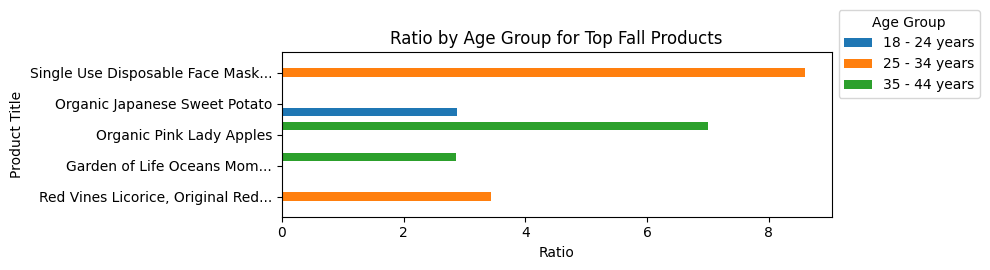

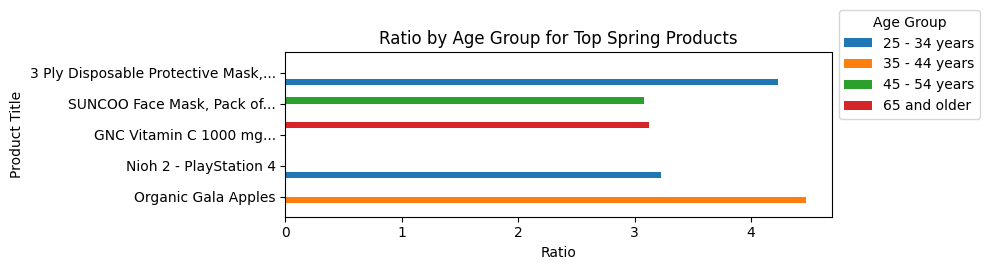

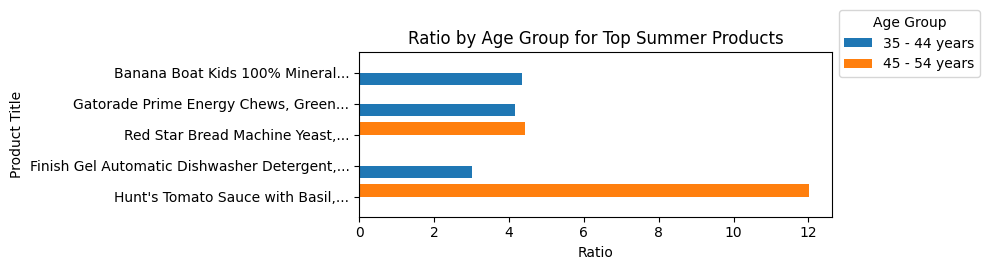

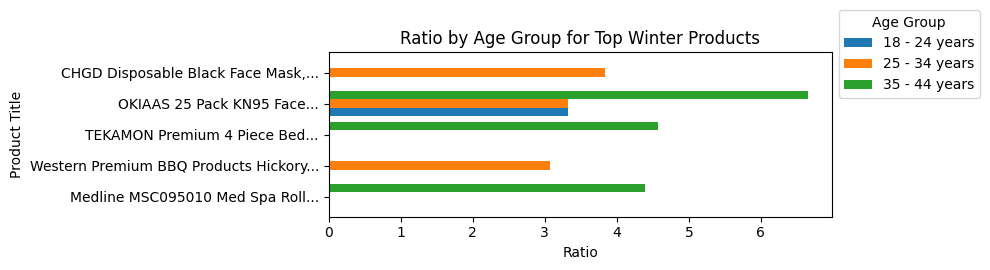

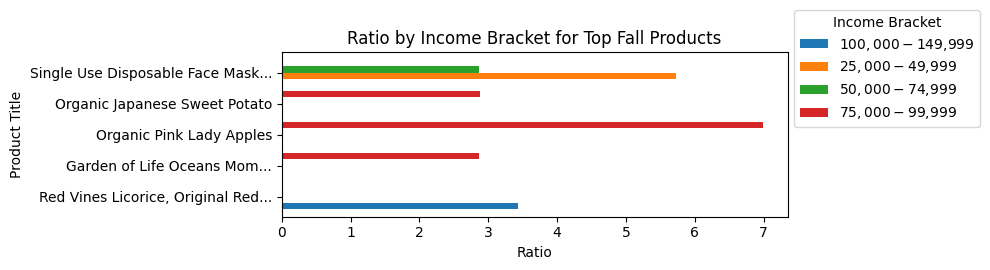

...

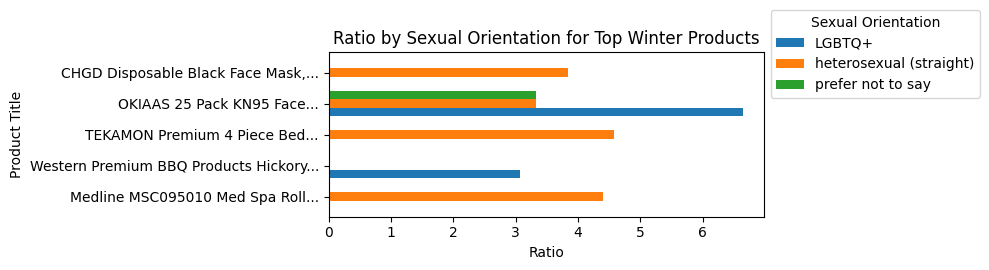

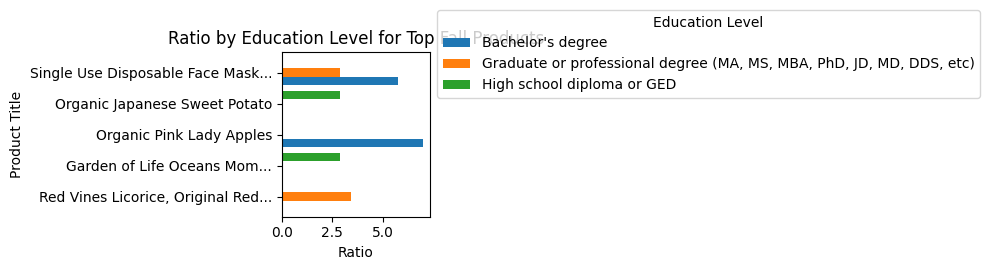

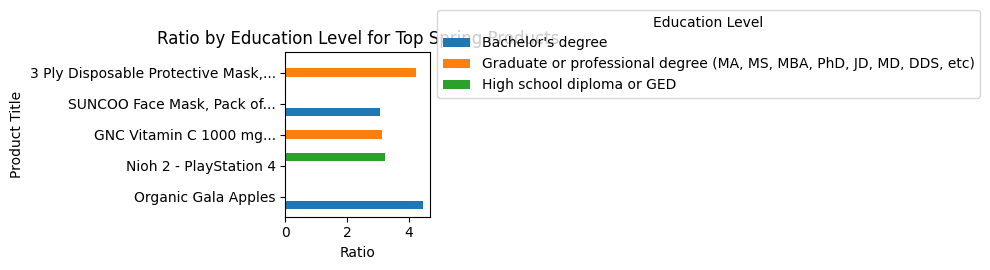

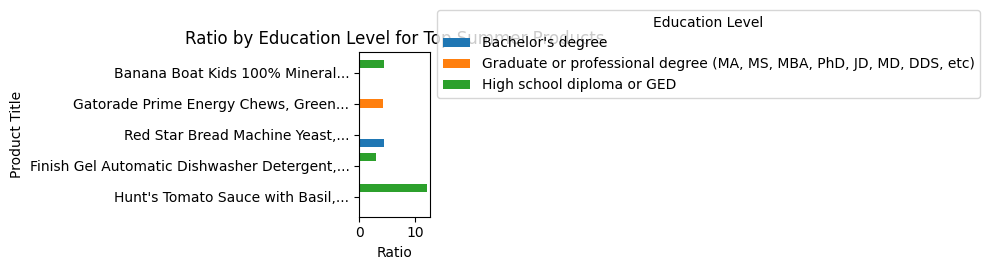

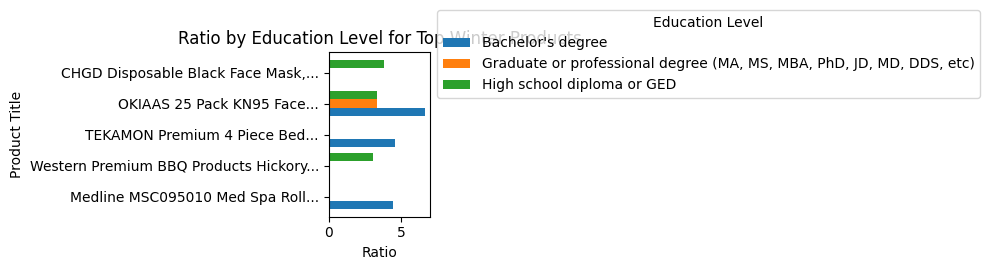

In [43]:
# Creating all the plots using the stored data

for demographic, val in demographic_stats.items():
  if demographic == "State":
    continue
  for season, curated_df in val.items():
    fig, ax = plot_by_group(
    curated_df,
    value_type="Ratio",
    demographic=demographic
    )
    # override the title to include the season
    ax.set_title(f"Ratio by {demographic} for Top {season} Products")
    plt.tight_layout()
    plt.show()


In [44]:
df = df.assign(
    _total_quantity = df.groupby('ASIN/ISBN (Product Code)')['Quantity'].transform('sum'),

).fillna(0)  # Handle cases where total_quantity=0 (ratio becomes NaN → set to 0)
df=df.assign(
    _ratio = df['Quantity'] / df['_total_quantity']
)

# Create pivot_ratios table showing sales ratio per season per product
pivot_ratios = pd.pivot_table(
    df,
    index='ASIN/ISBN (Product Code)',
    columns='Season',
    values='_ratio',
    aggfunc='sum',
    fill_value=0
)

# Ensure all season columns exist (Fall, Spring, Summer, Winter)
season_cols = ['Fall', 'Spring', 'Summer', 'Winter']
for season in season_cols:
    if season not in pivot_ratios.columns:
        pivot_ratios[season] = 0  # Add missing season columns with 0 values

pivot_ratios = pivot_ratios[season_cols]  # Reorder columns

# Filter: Keep only products that were sold in ALL seasons (ratio > 0 for every season)
mask_all_seasons_sold = (pivot_ratios > 0).all(axis=1)
pivot_ratios_filtered = pivot_ratios[mask_all_seasons_sold].copy()

# Merge product titles (optional)
pivot_ratios_filtered = pivot_ratios_filtered.merge(
    df[['ASIN/ISBN (Product Code)', 'Title']].drop_duplicates(),
    on='ASIN/ISBN (Product Code)',
    how='left'
)

# Display first 20 rows
pivot_ratios_filtered.head(20)

,ASIN/ISBN (Product Code),Fall,Spring,Summer,Winter,Title
0,0,inf,inf,inf,inf,Amazon.com eGift Card
1,0,inf,inf,inf,inf,Leg Avenue Women's Lurex Shimmer Anklet Socks
2,0,inf,inf,inf,inf,Women's Vintage Bow Tie High Heel Mary Janes P...
3,0,inf,inf,inf,inf,Amazon eGift Card - Birthday Cupcakes
4,0,inf,inf,inf,inf,0
5,0,inf,inf,inf,inf,Himalayan Salt Lamp 8-10” (7-11 lb) with Dimme...
6,0,inf,inf,inf,inf,Sleep Restoration Down Alternative Comforter 1...
7,0,inf,inf,inf,inf,Mellanni Full Size Sheet Set - Hotel Luxury 18...
8,0,inf,inf,inf,inf,The Nyche Designs Crisscross 2 Way Adjustable ...
9,0,inf,inf,inf,inf,"Quilted Northern Ultra Plush Toilet Paper, 12 ..."


In [45]:
# Create a long format version of the ratios data
ratio_long = pivot_ratios_filtered.copy()[['ASIN/ISBN (Product Code)', 'Title'] + season_cols]
ratio_long = ratio_long.melt(id_vars=['ASIN/ISBN (Product Code)', 'Title'],
              value_vars=season_cols,
              var_name='Season',
              value_name='Ratio',
              )

# Get top 5 products by ratio for each season
top5_ratios = (
    ratio_long
      .groupby('Season', group_keys=False)
      .apply(lambda x: x.nlargest(5, 'Ratio'))
      .reset_index(drop=True)
)

top5_ratios

<ipython-input-45-9a5a7dc34d81>:13: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,ASIN/ISBN (Product Code),Title,Season,Ratio
0,0,Amazon.com eGift Card,Fall,inf
1,0,Leg Avenue Women's Lurex Shimmer Anklet Socks,Fall,inf
2,0,Women's Vintage Bow Tie High Heel Mary Janes P...,Fall,inf
3,0,Amazon eGift Card - Birthday Cupcakes,Fall,inf
4,0,0,Fall,inf
5,0,Amazon.com eGift Card,Spring,inf
6,0,Leg Avenue Women's Lurex Shimmer Anklet Socks,Spring,inf
7,0,Women's Vintage Bow Tie High Heel Mary Janes P...,Spring,inf
8,0,Amazon eGift Card - Birthday Cupcakes,Spring,inf
9,0,0,Spring,inf


In [52]:
set_bars = 5  # Number of top products to show
def truncate_title(text, n_words=5):
    if pd.isna(text):
        return "No Title"
    if isinstance(text, (int, float)):
        return str(text)
    words = str(text).split()[:n_words]
    return ' '.join(words)
for season in season_cols:
    y = np.arange(set_bars)

    # Get data for each metric
    df_qty = top5_qty[top5_qty['Season'] == season].copy()
    df_rev = top5_rev[top5_rev['Season'] == season].copy()
    df_ratio = top5_ratios[top5_ratios['Season'] == season].copy()

    # Truncate titles for display
    for df in [df_qty, df_rev, df_ratio]:
        df['ShortTitle'] = df['Title'].apply(lambda t: truncate_title(t, n_words=5))

    # Create figure with 3 subplots
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(18, 4))

    # Quantity plot
    ax1.barh(y, df_qty['Quantity'], height=0.8, color='skyblue')
    ax1.set_yticks(y)
    ax1.set_yticklabels(df_qty['ShortTitle'], fontsize=8)
    ax1.set_title(f"Top 5 {season} by Quantity")
    ax1.set_xlabel('Units Sold')

    # Revenue plot
    ax2.barh(y, df_rev['Revenue'], height=0.8, color='salmon')
    ax2.set_yticks(y)
    ax2.set_yticklabels(df_rev['ShortTitle'], fontsize=8)
    ax2.set_title(f"Top 5 {season} by Revenue")
    ax2.set_xlabel('Revenue ($)')

    # Ratio plot
    ax3.barh(y, df_ratio['Ratio'], height=0.8, color='lightgreen')
    ax3.set_yticks(y)
    ax3.set_yticklabels(df_ratio['ShortTitle'], fontsize=8)
    ax3.set_title(f"Top 5 {season} by Ratio")
    ax3.set_xlabel('Seasonal Ratio')
    ax3.set_xlim(0, 1)  # Since ratios are between 0-1

    # Formatting
    fig.suptitle(f"Seasonal Performance Analysis - {season}", y=1.05, fontsize=12)
    fig.tight_layout()
    plt.show()



  ASIN/ISBN (Product Code)                                              Title  \
0                        0                              Amazon.com eGift Card   
1                        0      Leg Avenue Women's Lurex Shimmer Anklet Socks   
2                        0  Women's Vintage Bow Tie High Heel Mary Janes P...   
3                        0              Amazon eGift Card - Birthday Cupcakes   
4                        0                                                  0   

  Season  Ratio  
0   Fall    inf  
1   Fall    inf  
2   Fall    inf  
3   Fall    inf  
4   Fall    inf  
  ASIN/ISBN (Product Code)                                              Title  \
5                        0                              Amazon.com eGift Card   
6                        0      Leg Avenue Women's Lurex Shimmer Anklet Socks   
7                        0  Women's Vintage Bow Tie High Heel Mary Janes P...   
8                        0              Amazon eGift Card - Birthday Cupcakes   


# Machine Learning Section

This section creates a scatter plot that shows the groupings of products. This was mainly created in order to show outliers of products (but due to the amount of products, you can't see it without a good computer). There are three clusters (year round stables [amplitude <0.5], moderately seasonal [0.5 < x < 2.0], and seasonal and volatile [> 2.0]).

In [54]:
# Uses kmeans, standard scaling
# Does 'clustering'
# !pip install scikit-learn
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from IPython.display import display
import plotly.express as px

ml_df = full_price.copy().reset_index()


ml_df_melted= ml_df.melt(
    id_vars=["ASIN/ISBN (Product Code)", "Title", "AVG_PRICE", "CV_PRICE"],
    value_vars=season_cols,
    var_name="Season",
    value_name="Seasonal Price",
)

ml_df_melted["Sea_to_Avg"] = ml_df_melted["Seasonal Price"] / ml_df_melted["AVG_PRICE"]

features = ml_df_melted.groupby('ASIN/ISBN (Product Code)').agg(
    amplitude=('Sea_to_Avg', lambda x: x.max() - x.min()),
    mean_ratio=('Sea_to_Avg', 'mean'),
    cv=('CV_PRICE', 'mean')
).reset_index()

X = features[['amplitude', 'mean_ratio', 'cv']]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

kmeans = KMeans(n_clusters=3, random_state=42)
features['cluster'] = kmeans.fit_predict(X_scaled)

features_plot = features.rename(columns={'ASIN/ISBN (Product Code)': 'ASIN'})

fig = px.scatter(
    features,
    x='amplitude',
    y='cv',
    color='cluster',
    hover_data=['ASIN/ISBN (Product Code)'],
    title='Product Clusters with Hover Info',
)
fig.update_layout(
    xaxis_title='Amplitude (max-min Sea_to_Avg)',
    yaxis_title='Average CV_PRICE',
    legend_title='Cluster',
)
fig.show()



----- Classification Report (Test Set) -----

              precision    recall  f1-score   support

           0     1.0000    0.9900    0.9950      6204
           1     0.9997    1.0000    0.9998    181431

    accuracy                         0.9997    187635
   macro avg     0.9998    0.9950    0.9974    187635
weighted avg     0.9997    0.9997    0.9997    187635



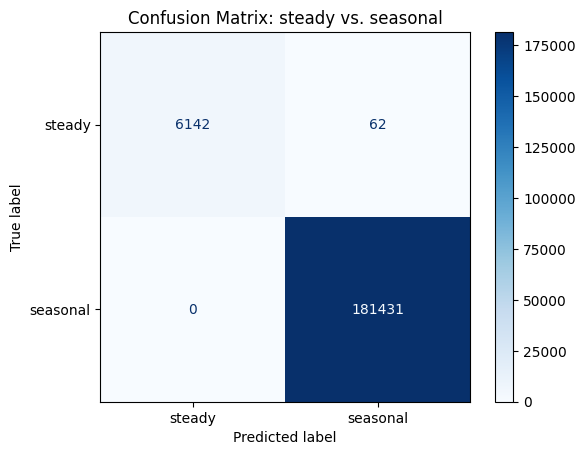

----- Feature Importances -----


,feature,importance
0,amplitude,0.363068
1,mean_ratio,0.355225
2,cv,0.281708


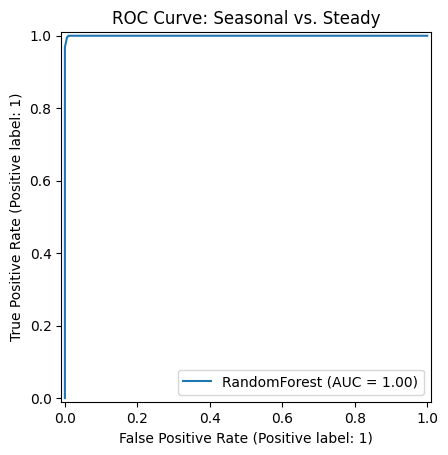

In [55]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report, ConfusionMatrixDisplay

# 1) Start from `full_price`, melt + compute Sea_to_Avg, then aggregate into per-product features

ml_df = full_price.copy().reset_index()

ml_df_melted = ml_df.melt(
    id_vars=["ASIN/ISBN (Product Code)", "Title", "AVG_PRICE", "CV_PRICE"],
    value_vars=season_cols,
    var_name="Season",
    value_name="Seasonal Price",
)
ml_df_melted["Sea_to_Avg"] = ml_df_melted["Seasonal Price"] / ml_df_melted["AVG_PRICE"]

features = (
    ml_df_melted
      .groupby("ASIN/ISBN (Product Code)")
      .agg(
          amplitude = ("Sea_to_Avg", lambda x: x.max() - x.min()),
          mean_ratio = ("Sea_to_Avg", "mean"),
          cv         = ("CV_PRICE", "mean")
      )
      .reset_index()
)

# 2) Define a binary target: is_seasonal
# ---------------------------------------------------
# For example, mark anything with amplitude ≥ median_amplitude as “seasonal” (label=1),
# the rest as “non-seasonal” (label=0).

median_amp = features["amplitude"].median()
features["is_seasonal"] = (features["amplitude"] >= median_amp).astype(int)

# 3) Split into train/test
# ---------------------------------------------------
X = features[["amplitude", "mean_ratio", "cv"]]
y = features["is_seasonal"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    stratify=y,
    random_state=42
)

# Build a Pipeline: scaling → random forest classifier
pipe = Pipeline([
    ("scaler", StandardScaler()),
    ("rf", RandomForestClassifier(
        n_estimators=100,
        max_depth=None,
        random_state=42
    ))
])

# Fit on training data
pipe.fit(X_train, y_train)

# Evaluate on test data

y_pred = pipe.predict(X_test)
print("----- Classification Report (Test Set) -----\n")
print(classification_report(y_test, y_pred, digits=4))

# plot a confusion matrix

disp = ConfusionMatrixDisplay.from_estimator(
    pipe, X_test, y_test,
    display_labels=["steady","seasonal"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Confusion Matrix: steady vs. seasonal")
plt.show()

# Feature Importances
# Because we used a RandomForest inside a Pipeline, we can grab it by:
rf_model = pipe.named_steps["rf"]
importances = rf_model.feature_importances_

feat_names = ["amplitude", "mean_ratio", "cv"]
feat_imp_df = pd.DataFrame({
    "feature": feat_names,
    "importance": importances
}).sort_values("importance", ascending=False)

print("----- Feature Importances -----")
display(feat_imp_df)


The results of above:

AUC = 1.00, meaning that the model is better at ranking true seasonal products above true steady ones. This score is hard to get in practice, so either something is wrong or more data is needed.

The feature importances are split almost evenly between amplitude, cv_price, and mean_ratio, so none of these should be removed.

On the confusion matrix, only 62 (1%) products were misclassified. Otherwise, this model is very "accurate", but do note how only 6204 products were classified as steady vs. seasonal.

Also note, the scores on the classification report are almost too perfect. This could indicate overfitting or have some sort of gap between training and the test. There is some imbalance that could be fixed by having a better data set. Although this dataset is well put together, it isn't substantial enough to warrant more supervised learning for some types of predictive analysis.

In [56]:
probs = pipe.predict_proba(X_test)[:, 1]   # [:,0] would be P(class=0); [:,1] is P(class=1)

# Build a small DataFrame to hold ASIN + features + prob
# Because we did train_test_split on X = features[["amplitude","mean_ratio","cv"]],
# X_test.index still matches the index of `features`. So we can recover ASINs like this:
test_asins = features.loc[X_test.index, "ASIN/ISBN (Product Code)"]

# Likewise recover the feature columns for those test rows:
test_amplitude = features.loc[X_test.index, "amplitude"]
test_mean_ratio = features.loc[X_test.index, "mean_ratio"]
test_cv = features.loc[X_test.index, "cv"]
test_true_label = y_test  # actual 0/1

# 3) Create a DataFrame for ranking
rank_df = pd.DataFrame({
    "ASIN": test_asins.values,
    "amplitude": test_amplitude.values,
    "mean_ratio": test_mean_ratio.values,
    "cv": test_cv.values,
    "prob_seasonal": probs,
    "true_label": test_true_label.values
}, index=X_test.index)

# 4) Sort descending by prob_seasonal
rank_df_sorted = rank_df.sort_values("prob_seasonal", ascending=False)

# 5) Pick your top N (e.g. N=10)
N = 10
topN = rank_df_sorted.head(N)

print(f"\n=== Top {N} Test‐Set Products by Predicted Probability of Seasonal ===")
display(topN[["ASIN","amplitude","mean_ratio","cv","prob_seasonal","true_label"]])

# check how many of these top N were actually seasonal:
actual_in_topN = topN["true_label"].sum()
print(f"Out of top {N}, {actual_in_topN} were truly seasonal (true_label=1).")


=== Top 10 Test‐Set Products by Predicted Probability of Seasonal ===


,ASIN,amplitude,mean_ratio,cv,prob_seasonal,true_label
762811,B08FD2CFTY,1.000000,0.250000,2.000000,1.0,1
569070,B07PHFKQWY,1.000000,0.250000,2.000000,1.0,1
832927,B08Y6G23Y3,1.000000,0.250000,2.000000,1.0,1
829720,B08XBDZDB7,1.000000,0.250000,2.000000,1.0,1
31159,143353732X,1.000000,0.250000,2.000000,1.0,1
520677,B07JGXP1HM,1.000000,0.250000,2.000000,1.0,1
347926,B071GVGFQF,1.082631,0.479342,1.173843,1.0,1
257408,B01ANP5US8,1.124019,0.500000,1.172326,1.0,1
671388,B0814T48DX,1.217581,0.500000,1.208129,1.0,1
758700,B08DR1DVJT,1.000000,0.250000,2.000000,1.0,1


Out of top 10, 10 were truly seasonal (true_label=1).


This code above finds the top 10 most seasonal products and cross checks it with products that had a true_label of 1.